<a href="https://colab.research.google.com/github/smkerr/EU_procurement/blob/main/assignment-2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# EU procurement contract networks (2008-2016)

Steve Kerr

For this assignment, I analyze the procurement contract networks of several EU countries using a subset of the data provided by Wachs, Fazekas, and Kertész in their 2020 paper entitled "[Corruption risk in contracting markets: a network science perspective](https://doi.org/10.1007/s41060-019-00204-1)." The entire [`eu_procurements_alt`](https://networks.skewed.de/net/eu_procurements_alt) data repository contains a collection of 234 networks representing the annual national public procurement markets of 26 European countries from 2008-2016. The data is sourced from Tenders Electronic Daily (TED), the official procurement portal of the European Union. In each network, nodes labeled with a "_i" suffix are issuers (sometimes referred to as buyers) of public contracts, for instance public hospitals, ministries, local governments. Nodes labeled with a "_w" suffix are winners (sometimes called suppliers) of public contracts, which are generally private-sector firms. Each network is bipartite, meaning that links represent contracting relationships between issuers and winners. To carry out our analysis, we will need to perform additional steps to account for the bipartite nature of these networks.

In addition to the sources cited at the end of this document, this notebook is a product of conversations with fellow classmates, StackOverflow queries, and assistance from ChatGPT when it came to understanding, troubleshooting, and commenting on the code.

# Setup

## Load packages

We begin by loading our dependencies. For this analysis, we will primarily be using the [`graph-tool`](https://graph-tool.skewed.de/static/doc/index.html) package, although we will also rely upon the [`NetworkX`](https://networkx.org/) package to create projections of our bipartite networks. Note that code by [Tiago P. Peixoto (@count0)](https://github.com/count0/colab-gt/blob/master/colab-gt.ipynb) is used to enable `graph-tool` within a [Google Colab](https://colab.research.google.com/) environment.

In [1]:
%%capture
!echo "deb http://downloads.skewed.de/apt jammy main" >> /etc/apt/sources.list
!apt-key adv --keyserver keyserver.ubuntu.com --recv-key 612DEFB798507F25
!apt-get update
!apt-get install python3-graph-tool python3-matplotlib python3-cairo

In [2]:
%%capture
!apt purge python3-cairo
!apt install libcairo2-dev pkg-config python3-dev
!pip install --force-reinstall pycairo
!pip install zstandard

In [3]:
import graph_tool.all as gt
import networkx as nx
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import os

## Load data

While data exists for 26 EU countries, the scope of this analysis is limited to just three countries: **Norway**, **Portugal**, and **Slovakia**. In the aforementioned paper by Wachs, Fazekas, and Kertész, Figure 1 plots each country's average single bidding rate, considered by the authors to be a proxy measure for possible corruption, across the entire period from 2008-2016. As you can see, **Norway** has one of the lowest single bidding rates (0.09), while **Slovakia** has one of the highest (0.35). **Portugal**, on the other hand, has a single bidding rate that places it squarely in the middle of the ranking (0.18). By selecting these three countries, I hope to learn something about the type of network properties that might be associated with different levels of supposed corruption.

![Wachs, Fazekas, and Kertész (2021) |  Fig 1](https://github.com/smkerr/EU_procurement/blob/65fd6f6a2abd28be435301bee21666150c9a31cb/lit-review/fig/Wachs%2C%20Fazekas%2C%20Kert%C3%A9sz_Fig1.png?raw=true)

Additionally, while the data exists for all years from 2008-2016, only data from **2010**, **2012**, **2014**, and **2016** is examined in this analysis. The reasoning being that this should be a sufficient number of years to determine the general network structure of a given country. Two year intervals are used to span a larger time period (2010-2016) without overcrowding the plots presented. At a future point, it may be worthwhile to expand the scope to include additional countries and additional years for a more robust analysis of network dynamics.

In [4]:
country_list = ['NO', 'PT', 'SK'] # Norway, Portugal, & Slovakia
year_list = range(2010, 2017, 2) # 2010, 2012, 2014, & 2016

# Create an empty dictionary to store networks
networks = {}

# Iterate over each country and year to import networks
for country in country_list:

  for year in year_list:

    network_title = f'{country}_{year}'
    networks[network_title] = gt.collection.ns[f'eu_procurements_alt/{network_title}']

In [5]:
# Inspect networks
networks

{'NO_2010': <Graph object, undirected, with 2265 vertices and 2673 edges, 2 internal vertex properties, 2 internal edge properties, 5 internal graph properties, at 0x789303f11ab0>,
 'NO_2012': <Graph object, undirected, with 2318 vertices and 2782 edges, 2 internal vertex properties, 2 internal edge properties, 5 internal graph properties, at 0x789303f120e0>,
 'NO_2014': <Graph object, undirected, with 2256 vertices and 2678 edges, 2 internal vertex properties, 2 internal edge properties, 5 internal graph properties, at 0x789303f127a0>,
 'NO_2016': <Graph object, undirected, with 2851 vertices and 3627 edges, 2 internal vertex properties, 2 internal edge properties, 5 internal graph properties, at 0x789303f12e60>,
 'PT_2010': <Graph object, undirected, with 1382 vertices and 1378 edges, 2 internal vertex properties, 2 internal edge properties, 5 internal graph properties, at 0x789303f13520>,
 'PT_2012': <Graph object, undirected, with 1175 vertices and 1123 edges, 2 internal vertex pro

## Create projections from bipartite network



The networks imported with `graph-tool` are bipartite. A bipartite network may be defined as a network that is partitioned into two sets (e.g., issuers and winners). As such, in order to perform a meaningful analysis, we will need to convert each bipartite network into two separate network projections, one for issuers and one for winners. Since `graph-tool` does not have a built-in capability for this, we rely on `NetworkX` for this task. However, in order to use `NetworkX`, we must first convert the networks from a `graph-tool` `Graph` class into a `NetworkX` `Graph` class. Once we have used `NetworkX` to create network projections, we will then convert the output into `graph-tool` `Graph` class objects so that we can perform the rest of our analysis using `graph-tool`.

In [6]:
# Initialize an empty dictionary to store networkx graphs
networks_nx = {}

for network, g_tool_graph in networks.items():

    # Initialize a new networkx graph for the current dataset
    g_nx = nx.Graph()

    # Add vertices and corresponding properties to the networkx graph
    for v in g_tool_graph.vertices():

        # Here, 'v_prop' is a dictionary of the vertex properties
        v_prop = {prop: g_tool_graph.vp[prop][v] for prop in g_tool_graph.vertex_properties.keys()}
        g_nx.add_node(v, **v_prop)

    # Add edges and corresponding properties to the networkx graph
    for e in g_tool_graph.edges():

        # Here, 'e_prop' is a dictionary of the edge properties
        e_prop = {prop: g_tool_graph.ep[prop][e] for prop in g_tool_graph.edge_properties.keys()}
        g_nx.add_edge(e.source(), e.target(), **e_prop)

    # Append the networkx graph to our dictionary
    networks_nx[network] = g_nx

In [7]:
# Initialize empty dictionary to store projections
networks_proj = {}

# Function to create and return both issuer and winner projections from a bipartite graph
def create_projections(g):

    issuers_set = {n for n, d in g.nodes(data=True) if d['label'].endswith('_i')}
    winners_set = {n for n, d in g.nodes(data=True) if d['label'].endswith('_w')}

    # Create the bipartite projections
    issuer_proj = nx.algorithms.bipartite.projected_graph(g, issuers_set)
    winner_proj = nx.algorithms.bipartite.projected_graph(g, winners_set)

    return issuer_proj, winner_proj

# Function to convert a networkx graph to a graph-tool graph
def convert_networkx_to_graphtool(g_nx, name_description):

    g_gt = gt.Graph(directed=False)
    pos_property = g_gt.new_vertex_property("vector<double>")
    label_property = g_gt.new_vertex_property("string")
    vertex_map = {node: g_gt.add_vertex() for node in g_nx}

    for node, data in g_nx.nodes(data=True):

        v = vertex_map[node]
        pos_property[v] = data.get('_pos', [0.0, 0.0])
        label_property[v] = data['label']

    for u, v in g_nx.edges():

        g_gt.add_edge(vertex_map[u], vertex_map[v])

    # Set the graph name and description properties
    g_gt.graph_properties["name"] = g_gt.new_graph_property("string", name_description[0])
    g_gt.graph_properties["description"] = g_gt.new_graph_property("string", name_description[1])

    return g_gt, pos_property, label_property

# Loop over each network in datasets_nx
for dataset_key, g_nx in networks_nx.items():

    # Split the key to get country and year
    country, year = dataset_key.split('_')

    # Create the projections
    issuer_proj, winner_proj = create_projections(g_nx)

    # Convert projections to graph-tool format
    name_description = (f"eu_procurements_alt ({country}_{year}_issuer)",
                        "Issuer projection of the bipartite graph")

    networks_proj[f"{country}_{year}_issuer"], _, _ = convert_networkx_to_graphtool(issuer_proj, name_description)

    name_description = (f"eu_procurements_alt ({country}_{year}_winner)",
                        "Winner projection of the bipartite graph")

    networks_proj[f"{country}_{year}_winner"], _, _ = convert_networkx_to_graphtool(winner_proj, name_description)

# Separate projections by winners and issuers
winners_proj = {network_title: g for network_title, g in networks_proj.items() if network_title.endswith('_winner')}
issuers_proj = {network_title: g for network_title, g in networks_proj.items() if network_title.endswith('_issuer')}


# Overall network properties


Despite having gone through all of this effort to create projections of our networks, there may still be some value in analyzing several properties of the overall network such as degree distribution.

## General properties

Using data from **Norway** in **2010** as an example, we get an idea for the basic properties present in each network. Both number of nodes and number of links appear to be somewhere in the low thousands which may not be incredibly large but should still be large enough to test our understanding of emergent network properties. In terms of node properties, each node has a **`label`** that serves as a unique identifier where contract issuers have a "_i" suffix and contract winners have a "_w" suffix. Beyond this, each node also has a built-in **`_pos`** property which defines its default position when plotted. Links have both a **`count`** property, indicating the number of contracts shared between a given issuer-winner pair, as well as a **`pctSingleBid`** property, corresponding with the percentage of contracts of a given issuer-winner pair that only attracted a single bidder which is considered by Wachs, Fazekas, and Kertész to be an effective proxy for corruption. Where no information is available on the number of bidders for a particular contract, the authors impute the value to be equal to the country's average single bid rate.

In [8]:
networks['NO_2010']

<Graph object, undirected, with 2265 vertices and 2673 edges, 2 internal vertex properties, 2 internal edge properties, 5 internal graph properties, at 0x789303f11ab0>

In [9]:
networks['NO_2010'].list_properties()

name             (graph)   (type: string, val: eu_procurements_alt (NO_2010))
description      (graph)   (type: string, val: These 234 networks represent the
                                               annual national public
                                               procurement markets of 26
                                               European countries from
                                               2008-2016, inclusive. Data is
                                               sourced from Tenders Electronic
                                               Daily (TED), the official
                                               procurement portal of the
                                               European Union.  Nodes with the
                                               suffix "_i" are issuers
                                               (sometimes referred to as
                                               buyers) of public contracts, for
                       

## Degree distribution

The image below shows the degree distribution plots for all three countries: **Norway** (NO), **Portugal** (PT), and **Slovakia** (SK) for **2010**, **2012**, **2014**, and **2016**. Note that these are bipartite networks, so the degrees represent the number of connections between issuers and winners per node. We have used a log-scale on both the x- and y-axes, a common approach for visualizing power-law distributions in networks. The error bars capture the uncertainty in the degree measurements. All of the plots follow a similar trend where there are many nodes with few connections and few nodes with many connections. Note that there seem to be a few outlier nodes which are significantly more connected than all others, for example, **Portugal** in **2014** and **2016**, and **Slovakia** in **2016**. Overall, the degree distribution appears to follow the power law distribution rather than a poisson distribution which is what we would expect of the degrees of a “scale-free” network according to the Albert-Barabási model.

In [10]:
# Determine the layout of the subplots
cols = 4
rows = int(np.ceil(len(networks) / float(cols)))

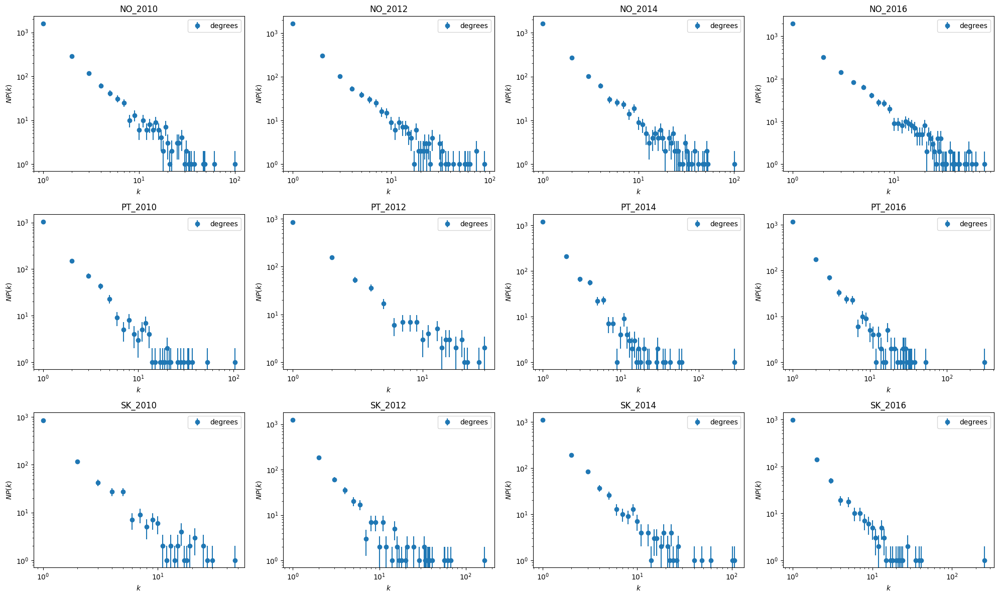

In [11]:
# Create a figure with subplots
fig, axes = plt.subplots(rows, cols, figsize=(cols * 5, rows * 4))
plt.subplots_adjust(wspace=0.4, hspace=0.6)

# Flatten the axes array for easy iteration
axes = axes.flatten()

# Loop through each dataset and create plots
for i, (network_title, g) in enumerate(networks.items()):

    ax = axes[i]
    hist = gt.vertex_hist(g, "total")
    y = hist[0]
    err = np.sqrt(hist[0])
    ax.errorbar(hist[1][:-1], y, fmt="o", yerr=err, label="degrees")
    ax.set_yscale("log")
    ax.set_xscale("log")
    ax.set_xlabel("$k$")
    ax.set_ylabel("$NP(k)$")
    ax.set_title(network_title)
    ax.legend()

plt.tight_layout()
plt.show()

## Layouts

In order to recreate a version of Figure 4 from the paper by Wachs, Fazekas, and Kertész, we create a custom function that colors nodes and links depending on their properties. Issuer nodes are colored gray, while winner nodes are colored white. Links with an above 50% single bidding rate are colored red, while those with an average of below 50% are colored blue. Additionally, link sizes correspond with the number of contracts shared between a given issuer-winner pair.

![Fig 2](https://raw.githubusercontent.com/smkerr/EU_procurement/main/lit-review/fig/Wachs%2C%20Fazekas%2C%20Kert%C3%A9sz_Fig4.png)

In [12]:
# Function to add drawing parameters to a graph-tool graph using the node and edge properties.
def draw_weighted_colored_graph(u, edge_color_property_name='edge_color'):

    # Retrieve the 'count' and 'pctSingleBid' edge properties
    edge_count = u.ep["count"]
    edge_pctSingleBid = u.ep["pctSingleBid"]

    # Create a new edge property for the matplotlib color mapping
    edge_color = u.new_edge_property('vector<double>')
    u.ep[edge_color_property_name] = edge_color

    # Create color maps and normalization instance for edges
    cmap = plt.get_cmap('coolwarm')
    norm = matplotlib.colors.Normalize(vmin=0, vmax=1)  # 'pctSingleBid' is between 0 and 1

    # Assign colors to edges based on 'pctSingleBid' values
    for e in u.edges():
        normalized_value = norm(edge_pctSingleBid[e])
        edge_color[e] = cmap(normalized_value)

    # Prepare vertex color properties
    vertex_fill_color = u.new_vertex_property('vector<double>')
    vertex_outline = u.new_vertex_property('vector<double>')  # For the boundary

    # Check the vertex 'label' property and assign colors accordingly
    for v in u.vertices():
        label = u.vp.label[v]
        if label.endswith("_i"):  # Check if the vertex label ends with '_i'
            vertex_fill_color[v] = [0.5, 0.5, 0.5, 1]  # Gray for issuers
        elif label.endswith("_w"):  # Check if the vertex label ends with '_w'
            vertex_fill_color[v] = [1, 1, 1, 1]  # White for winners
        vertex_outline[v] = [0, 0, 0, 1]  # Black outline for all vertices

    # Prepare the dictionary with drawing parameters
    drawing_parameters = {
        'edge_color': edge_color,
        'edge_pen_width': gt.prop_to_size(edge_count, mi=0.5, ma=25, power=1),
        'vertex_fill_color': vertex_fill_color,
        'vertex_color': vertex_outline,  # This is for the boundary
        'vertex_pen_width': 1.2  # Adjust the pen width as needed
    }

    return drawing_parameters

### Default layout

The plots below show the largest component of the public procurement networks for **Norway**, **Portugal**, and **Slovakia** for **2010**, **2012**, **2014**, and **2016**. Issuer nodes are colored gray, while winner nodes are colored white. Links with a single bidding rate greater than 50% are colored red. Link sizes correspond with the number of contracts between a given issuer-winner pair. **Norway**'s network appears to be fairly uniformly distributed with many nodes near the center and few nodes on the peripherary. There are also very few red links. **Portugal**'s network is sparser than Norway's and includes several branches that are somewhat distanced from the center of the plot. In all four years plotted, there appears to be a cluster of red links. **Slovakia**'s  network is structured somewhat similarly to Portugal's in that there are several branches with some distance from the center. There are more red links distributed throughout the network in all years examined.

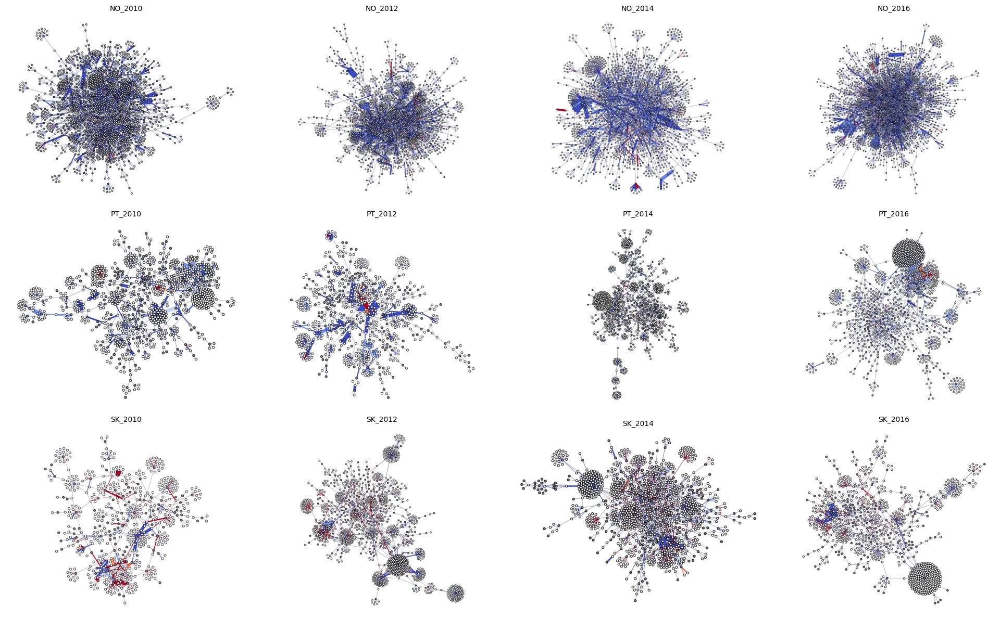

In [13]:
# Ensure the output directory exists for the stored positions
output_dir_vp = "default_layout"
os.makedirs(output_dir_vp, exist_ok=True)

# Loop through each dataset and save the graph using the stored positions as an image
for network_title, g in networks.items():
    u = gt.extract_largest_component(g, prune=True)
    output_path = os.path.join(output_dir_vp, f"{network_title}.png")
    drawing_parameters = draw_weighted_colored_graph(u)
    gt.graph_draw(u, pos=u.vp["_pos"], output=output_path,**drawing_parameters)

# Get the list of all saved images for the stored positions
image_files_vp = sorted([os.path.join(output_dir_vp, f) for f in os.listdir(output_dir_vp) if f.endswith('.png')])

# Create the figure with subplots for the stored positions
fig, axes = plt.subplots(rows, cols, figsize=(cols * 5, rows * 4))

# Flatten the axes array for easy iteration
axes = axes.flatten()

# Loop through each image file for the stored positions and add it to the subplot
for i, image_file in enumerate(image_files_vp):
    img = mpimg.imread(image_file)
    axes[i].imshow(img)
    axes[i].axis('off')  # Hide the axes

    # Set the title for the subplot
    axes[i].set_title(image_file.split('/')[-1].replace('.png', ''), fontsize=10)

# Adjust the layout and show the visualization
plt.tight_layout()
plt.show()

### Scalable Force-Directed Placement (SFDP) spring-block layout

The image below shows an alternate layout for our network. Many of the same properties described in the plot above remain true of the plot below. The SFDP spring-block layout primarily appears to make the network's nodes and links easier to view.

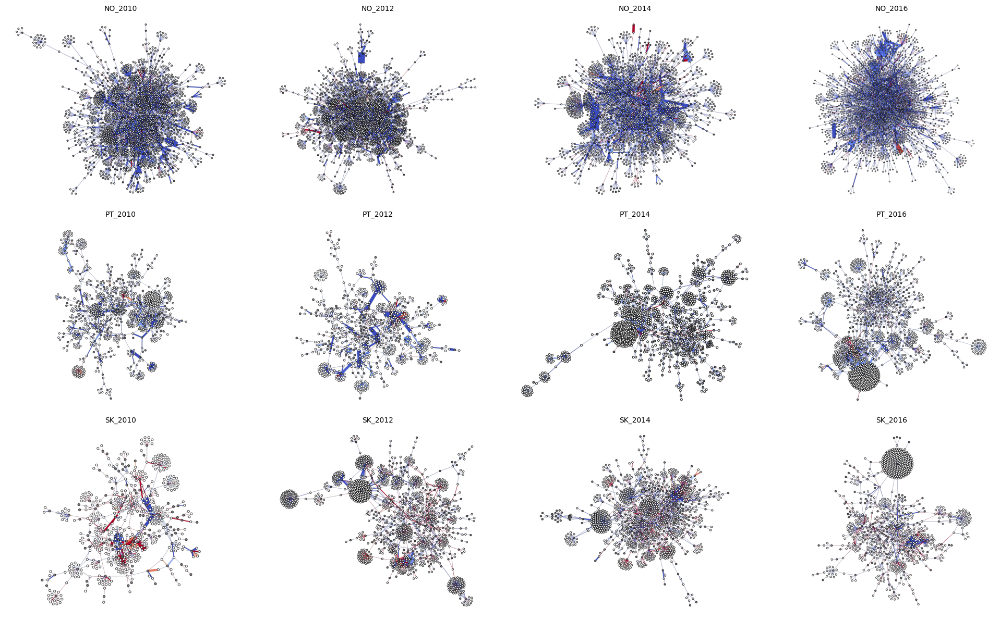

In [14]:
# Ensure the output directory exists
output_dir = "sfdp_layout"
os.makedirs(output_dir, exist_ok=True)

# Loop through each dataset and save the graph as an image
for network_title, g in networks.items():
    u = gt.extract_largest_component(g, prune=True)
    pos = gt.sfdp_layout(u)
    output_path = os.path.join(output_dir, f"{network_title}.png")
    drawing_parameters = draw_weighted_colored_graph(u)
    gt.graph_draw(u, pos, output=output_path, **drawing_parameters)


# Get the list of all saved images
image_files = sorted([os.path.join(output_dir, f) for f in os.listdir(output_dir) if f.endswith('.png')])

# Create the figure with subplots
fig, axes = plt.subplots(rows, cols, figsize=(cols * 5, rows * 4))

# Flatten the axes array for easy iteration, in case of a 2D axes array
axes = axes.flatten()

# Loop through each image file and add it to the subplot
for i, image_file in enumerate(image_files):
    img = mpimg.imread(image_file)
    axes[i].imshow(img)
    axes[i].axis('off')  # Turn off the axis

    # Set the title for the subplot using the filename
    axes[i].set_title(image_file.split('/')[-1].replace('.png', ''), fontsize=10)

# Adjust layout and display
plt.tight_layout()
plt.show()

### Fruchterman-Reingold spring-block layout

The Fruchterman-Reingold layout represents yet another approach to representing our networks. This method attempts to achieve uniform link length to more closely approximate force in natural systems. As with the plot above, the interpretation of the networks does not change, but the layout perhaps makes it easier to note the level of centralization present in a network and take notice of clusters present in the networks.

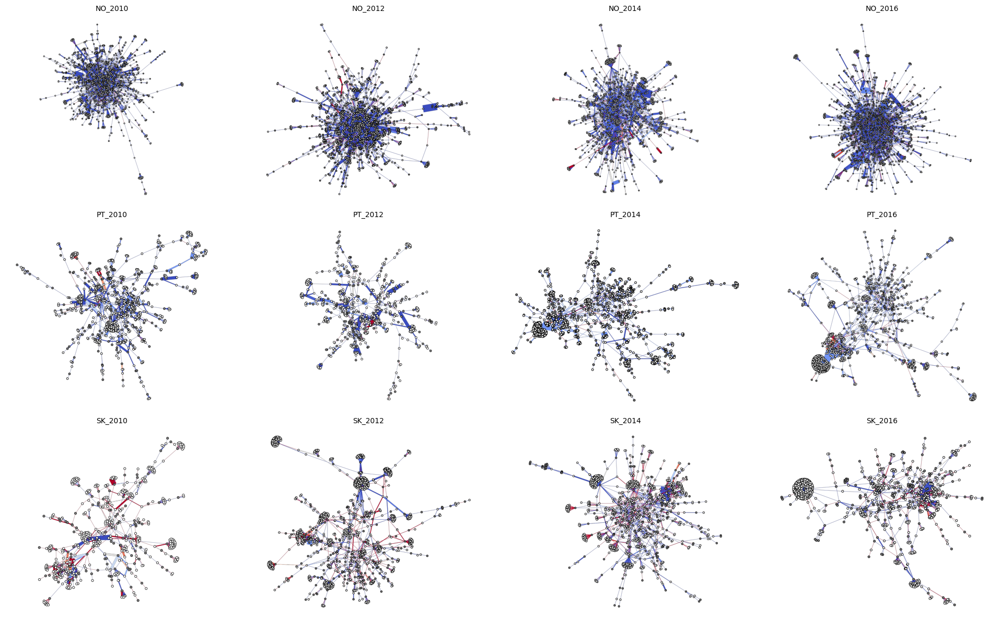

In [15]:
# Ensure the output directory exists for Fruchterman-Reingold layouts
output_dir_fr = "fr_layout"
os.makedirs(output_dir_fr, exist_ok=True)

# Loop through each dataset and save the graph with Fruchterman-Reingold layout as an image
for network_title, g in networks.items():
    u = gt.extract_largest_component(g, prune=True)
    pos_fr = gt.fruchterman_reingold_layout(u, n_iter=100)  # Set the number of iterations if needed
    output_path = os.path.join(output_dir_fr, f"{network_title}.png")
    drawing_parameters = draw_weighted_colored_graph(u)
    gt.graph_draw(u, pos_fr, output=output_path, **drawing_parameters)

# Get the list of all saved images for Fruchterman-Reingold layouts
image_files_fr = sorted([os.path.join(output_dir_fr, f) for f in os.listdir(output_dir_fr) if f.endswith('.png')])

# Create the figure with subplots for Fruchterman-Reingold layouts
fig, axes = plt.subplots(rows, cols, figsize=(cols * 5, rows * 4))

# Flatten the axes array for easy iteration
axes = axes.flatten()

# Loop through each image file for Fruchterman-Reingold layouts and add it to the subplot
for i, image_file in enumerate(image_files_fr):
    img = mpimg.imread(image_file)
    axes[i].imshow(img)
    axes[i].axis('off')  # Hide the axes

    # Set the title for the subplot
    axes[i].set_title(image_file.split('/')[-1].replace('.png', ''), fontsize=10)

# Adjust the layout and show the visualization
plt.tight_layout()
plt.show()

# Projected network properties

While we can obtain some interesting insights from our networks by looking at them as a whole, due to their bipartite nature, most of our metrics for evaluating networks are more appropriate when applied to their projections. As described above, we have previously converted each country's network into a issuer projection and a winner projection. We will be using these network projections going forward to evaluate metrics such as various centrality measures, community detection, and hierarchy.

## General properties

Using data from **Norway** in **2010** as an example, we get an idea for the basic properties present in each network projection. The number of nodes and edges are understandably lower for both issuer and winner projections when compared to the original bipartite network. This makes sense considering both projections contain just a subset of the nodes from the original bipartite network. It is important to note that the links here tell us that a given issuer-issuer or winner-winner pair both worked with the same issuer or winner in a given year. Additionally, the network projections do not contain node or link properties since these were lost when converting between `graph-tool` `Graph` class objects to `NetworkX` `Graph` class objects and back again, however, we can still proceed with our analysis since many of the node and link properties such as **`_pos`**, **`count`** and **`pctSingleBid`** do not apply as directly to this context.

In [16]:
networks_proj['NO_2010_issuer'], networks_proj['NO_2010_winner']

(<Graph object, undirected, with 485 vertices and 2306 edges, 2 internal graph properties, at 0x789303d47fa0>,
 <Graph object, undirected, with 1780 vertices and 24242 edges, 2 internal graph properties, at 0x789303d47340>)

In [17]:
networks_proj['NO_2010_issuer'].list_properties()

name            (graph)   (type: string, val: eu_procurements_alt
                                              (NO_2010_issuer))
description     (graph)   (type: string, val: Issuer projection of the
                                              bipartite graph)


## Degree distribution

The image below shows the degree distribution plots for the issuers in all three countries: **Norway**, **Portugal**, and **Slovakia** for **2010**, **2012**, **2014**, and **2016**. Note that these are network projections, so the degrees represent the number of issuer-issuer pairs that have a contract with the same winner. We have used a log-scale on both the x- and y-axes, a common approach for visualizing power-law distributions in networks. The error bars capture the uncertainty in the degree measurements. All of the plots follow a similar trend where there are many nodes with few connections and fewer nodes with many connections. That said, there are quite a lot of hubs of slightly varying degrees clusterd in the bottom right-hand section of these plots. Overall, the degree distribution appears to follow the power law distribution rather than a poisson distribution which is what we would expect of the degrees of a “scale-free” network according to the Albert-Barabási model.

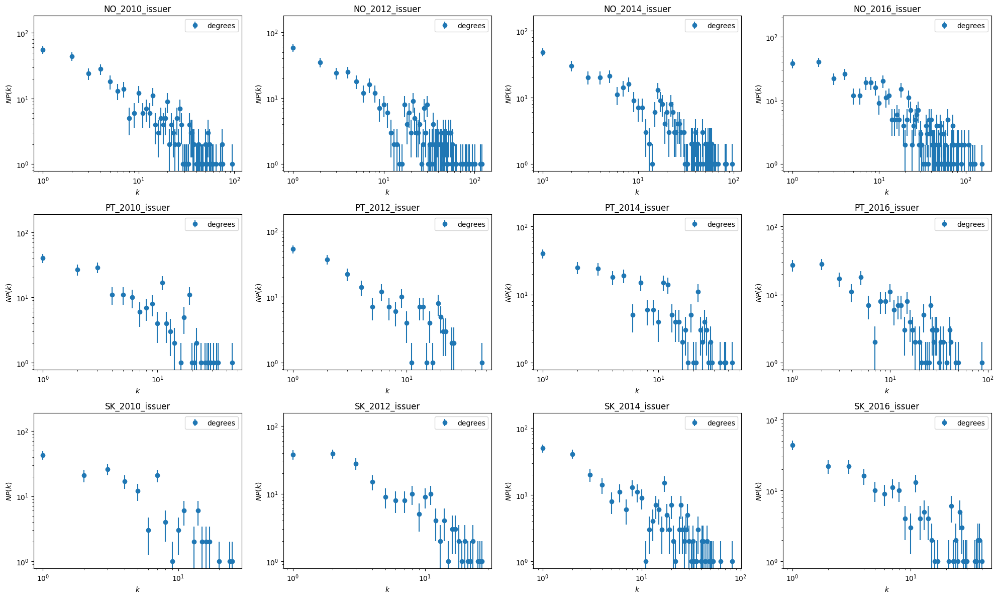

In [18]:
# Create a figure with subplots
fig, axes = plt.subplots(rows, cols, figsize=(cols * 5, rows * 4))
plt.subplots_adjust(wspace=0.4, hspace=0.6)

# Flatten the axes array for easy iteration
axes = axes.flatten()

# Loop through each dataset and create plots
for i, (network_title, g) in enumerate(issuers_proj.items()):

    ax = axes[i]
    hist = gt.vertex_hist(g, "total")
    y = hist[0]
    err = np.sqrt(hist[0])
    ax.errorbar(hist[1][:-1], y, fmt="o", yerr=err, label="degrees")
    ax.set_yscale("log")
    ax.set_xscale("log")
    ax.set_xlabel("$k$")
    ax.set_ylabel("$NP(k)$")
    ax.set_title(network_title)
    ax.legend()

plt.tight_layout()
plt.show()

The image below shows the degree distribution plots for the winners in all three countries: **Norway**, **Portugal**, and **Slovakia** for **2010**, **2012**, **2014**, and **2016**. Note that these are network projections, so the degrees represent the number of winner-winner pairs that have a contract with the same issuer. We have used a log-scale on both the x- and y-axes, a common approach for visualizing power-law distributions in networks. The error bars capture the uncertainty in the degree measurements. The plots appear to share a similar trend where there a appear to be a cluser of hubs of slightly varying degrees in the bottom right-hand section of the plots. Interestingly, most plots appear to have a cluster of points towards the top of the plot, stretching between the upper left-hand side to the center, indicating the there are a high number of nodes with a low to medium number of degrees. As such, these plots don't appear to closely with the power law distribution, indicating that some other dynamic might be at work.

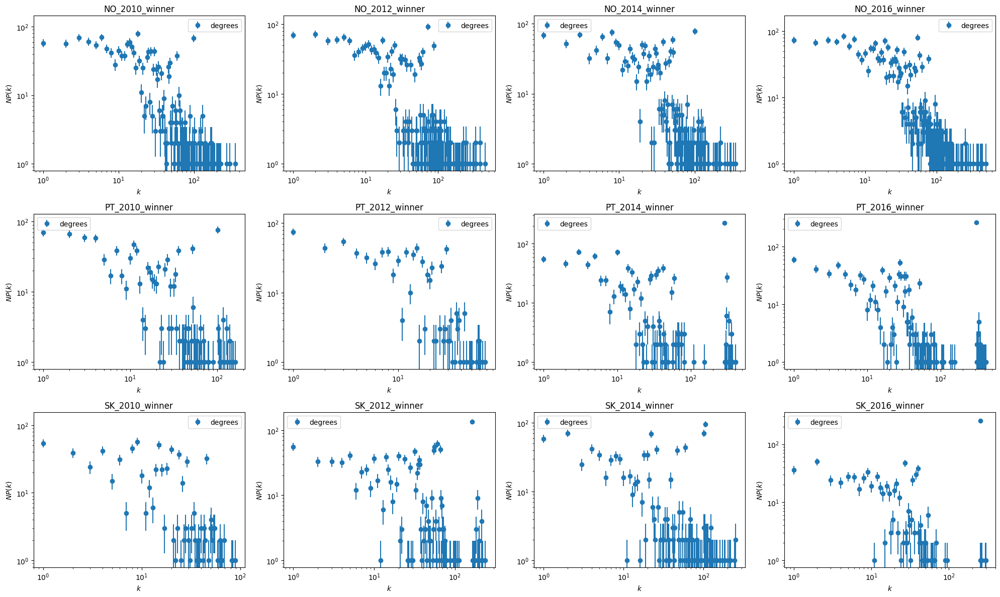

In [19]:
# Create a figure with subplots
fig, axes = plt.subplots(rows, cols, figsize=(cols * 5, rows * 4))
plt.subplots_adjust(wspace=0.4, hspace=0.6)

# Flatten the axes array for easy iteration
axes = axes.flatten()

# Loop through each dataset and create plots
for i, (network_title, g) in enumerate(winners_proj.items()):

    ax = axes[i]
    hist = gt.vertex_hist(g, "total")
    y = hist[0]
    err = np.sqrt(hist[0])
    ax.errorbar(hist[1][:-1], y, fmt="o", yerr=err, label="degrees")
    ax.set_yscale("log")
    ax.set_xscale("log")
    ax.set_xlabel("$k$")
    ax.set_ylabel("$NP(k)$")
    ax.set_title(network_title)
    ax.legend()

plt.tight_layout()
plt.show()

## Diameters

The diameter of the network represents the longest shortest path in a network, or the distance between the two furthest nodes. In our case, it applies to issuers and winners respectively. The paths are computed with a breadth-first search (BFS). As we can see, the diameters for the issuers tend to be slightly smaller than the diameters for the winners.

In [20]:
for network_title, g in issuers_proj.items():
  g = networks_proj[network_title]
  u = gt.extract_largest_component(g, prune=True)
  dist, ends = gt.pseudo_diameter(u)
  print(network_title, dist)

NO_2010_issuer 7.0
NO_2012_issuer 7.0
NO_2014_issuer 6.0
NO_2016_issuer 6.0
PT_2010_issuer 9.0
PT_2012_issuer 9.0
PT_2014_issuer 9.0
PT_2016_issuer 8.0
SK_2010_issuer 6.0
SK_2012_issuer 8.0
SK_2014_issuer 7.0
SK_2016_issuer 8.0


In [21]:
for network_title, g in winners_proj.items():
  g = networks_proj[network_title]
  u = gt.extract_largest_component(g, prune=True)
  dist, ends = gt.pseudo_diameter(u)
  print(network_title, dist)

NO_2010_winner 8.0
NO_2012_winner 8.0
NO_2014_winner 6.0
NO_2016_winner 7.0
PT_2010_winner 9.0
PT_2012_winner 10.0
PT_2014_winner 10.0
PT_2016_winner 8.0
SK_2010_winner 7.0
SK_2012_winner 8.0
SK_2014_winner 6.0
SK_2016_winner 8.0


## Layouts

### Scalable Force-Directed Placement (SFDP) spring-block layout

The plots below show the largest component of the projected public procurement networks for issuers in **Norway**, **Portugal**, and **Slovakia** for **2010**, **2012**, **2014**, and **2016**. Here we use the SFDP spring-block layout. **Norway**'s network projection appears to be fairly uniformly spread about the plot with many nodes near the center and few nodes on the peripherary. **Portugal**'s network projection is sparser than Norway's and appears to be a bit less centralized as well. **Slovakia**'s  network projection appears to fluctuate over time, as in 2010 it appears rather de-centralized with what appears to be several disctinct clusters while in 2014 and 2016, its issuer network projection appears much more centralized.

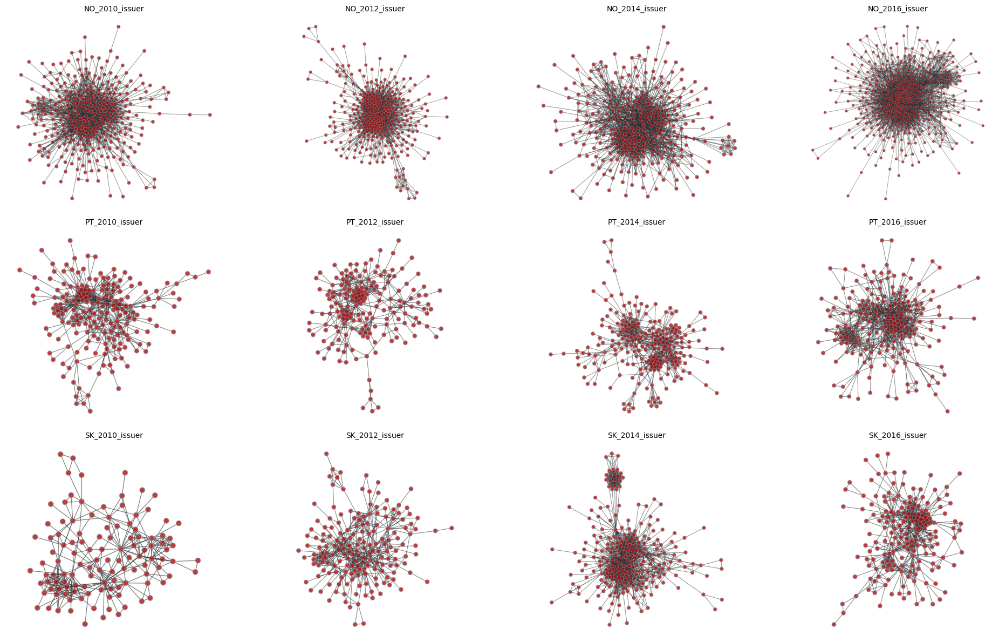

In [22]:
# Ensure the output directory exists
output_dir = "sfdp_layout_i"
os.makedirs(output_dir, exist_ok=True)

# Loop through each dataset and save the graph as an image
for network_title, g in issuers_proj.items():
    u = gt.extract_largest_component(g, prune=True)
    pos = gt.sfdp_layout(u)
    output_path = os.path.join(output_dir, f"{network_title}.png")
    gt.graph_draw(u, pos, output=output_path)

# Get the list of all saved images
image_files = sorted([os.path.join(output_dir, f) for f in os.listdir(output_dir) if f.endswith('.png')])

# Create the figure with subplots
fig, axes = plt.subplots(rows, cols, figsize=(cols * 5, rows * 4))

# Flatten the axes array for easy iteration, in case of a 2D axes array
axes = axes.flatten()

# Loop through each image file and add it to the subplot
for i, image_file in enumerate(image_files):
    img = mpimg.imread(image_file)
    axes[i].imshow(img)
    axes[i].axis('off')  # Turn off the axis
    # Set the title for the subplot using the filename
    axes[i].set_title(image_file.split('/')[-1].replace('.png', ''), fontsize=10)

# Adjust layout and display
plt.tight_layout()
plt.show()

The plots below show the largest component of the projected public procurement networks for winners in **Norway**, **Portugal**, and **Slovakia** for **2010**, **2012**, **2014**, and **2016**. Again, we use the SFDP spring-block layout. **Norway**'s network projection still appears centralized, similarly to its network of issuers, however there appear to be more visibly apparent clusters. Similarly, the plots for **Portugal** and **Slovakia** appear to contain more clusters that in their respective issuer networks which also appear to be quite clearly delineated. The overall network structure remains similar to the issuer network plotted above.

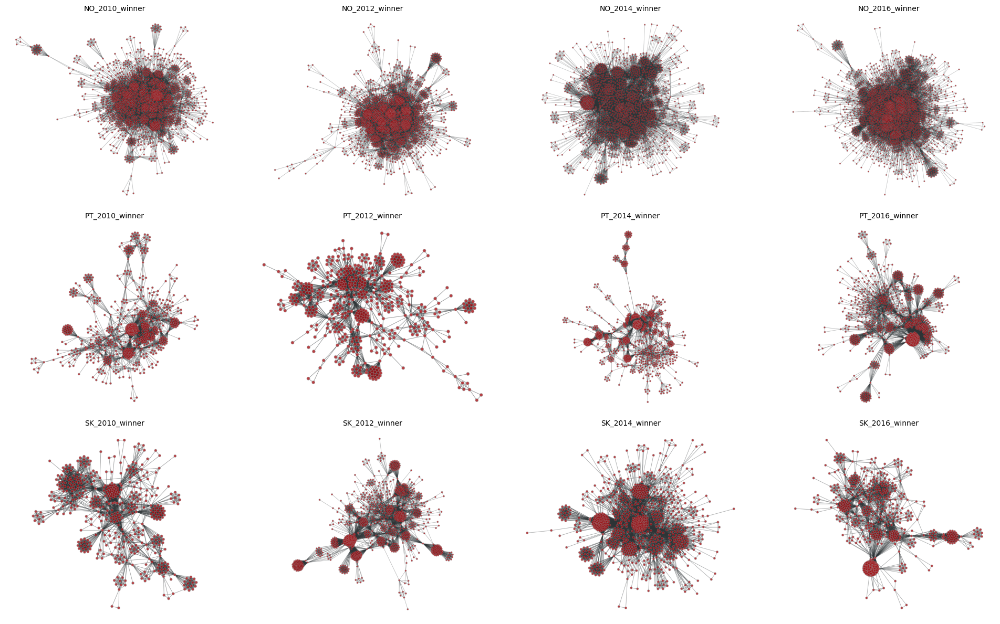

In [23]:
# Ensure the output directory exists
output_dir = "sfdp_layout_w"
os.makedirs(output_dir, exist_ok=True)

# Loop through each dataset and save the graph as an image
for network_title, g in winners_proj.items():
    u = gt.extract_largest_component(g, prune=True)
    pos = gt.sfdp_layout(u)
    output_path = os.path.join(output_dir, f"{network_title}.png")
    gt.graph_draw(u, pos, output=output_path)

# Get the list of all saved images
image_files = sorted([os.path.join(output_dir, f) for f in os.listdir(output_dir) if f.endswith('.png')])

# Create the figure with subplots
fig, axes = plt.subplots(rows, cols, figsize=(cols * 5, rows * 4))

# Flatten the axes array for easy iteration, in case of a 2D axes array
axes = axes.flatten()

# Loop through each image file and add it to the subplot
for i, image_file in enumerate(image_files):
    img = mpimg.imread(image_file)
    axes[i].imshow(img)
    axes[i].axis('off')  # Turn off the axis
    # Set the title for the subplot using the filename
    axes[i].set_title(image_file.split('/')[-1].replace('.png', ''), fontsize=10)

# Adjust layout and display
plt.tight_layout()
plt.show()

### Fruchterman-Reingold spring-block layout

The Fruchterman-Reingold layout represents yet another approach to representing our network projections. This method attempts to achieve uniform link length to more closely approximate force in natural systems. As with the plots above which use a SFDP layout, **Norway** appears to have a consistently dense and centralized network of issuers. **Portugal**'s issuer projection is sparser with a few branches observed. As observed above, **Slovakia**'s issuer projection appears to fluctuate over time.

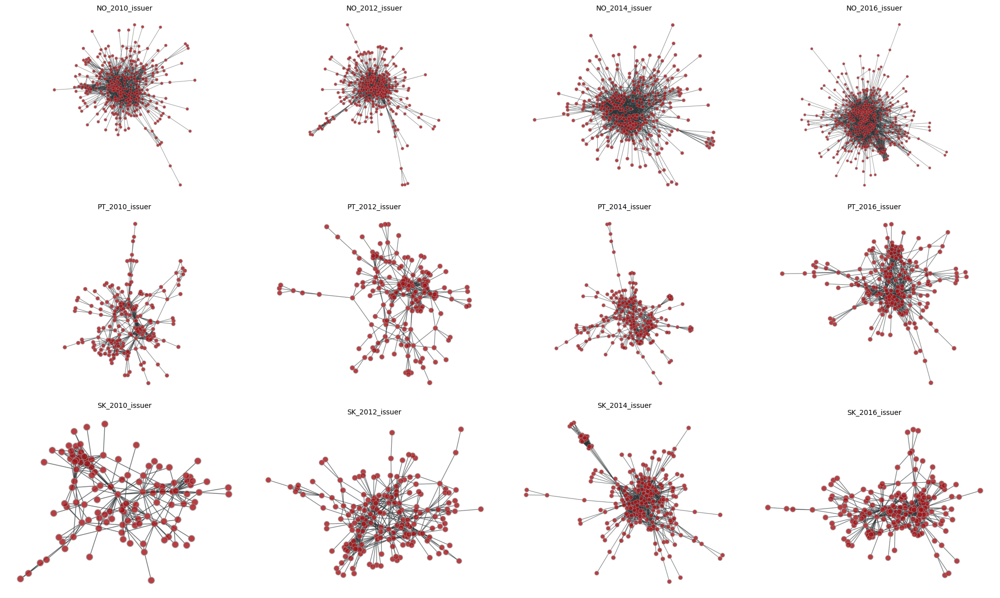

In [24]:
# Ensure the output directory exists
output_dir = "fr_layout_i"
os.makedirs(output_dir, exist_ok=True)

# Loop through each dataset and save the graph as an image
for network_title, g in issuers_proj.items():
    u = gt.extract_largest_component(g, prune=True)
    pos = gt.fruchterman_reingold_layout(u, n_iter=100)
    output_path = os.path.join(output_dir, f"{network_title}.png")
    gt.graph_draw(u, pos, output=output_path)

# Get the list of all saved images
image_files = sorted([os.path.join(output_dir, f) for f in os.listdir(output_dir) if f.endswith('.png')])

# Create the figure with subplots
fig, axes = plt.subplots(rows, cols, figsize=(cols * 5, rows * 4))

# Flatten the axes array for easy iteration, in case of a 2D axes array
axes = axes.flatten()

# Loop through each image file and add it to the subplot
for i, image_file in enumerate(image_files):
    img = mpimg.imread(image_file)
    axes[i].imshow(img)
    axes[i].axis('off')  # Turn off the axis
    # Set the title for the subplot using the filename
    axes[i].set_title(image_file.split('/')[-1].replace('.png', ''), fontsize=10)

# Adjust layout and display
plt.tight_layout()
plt.show()

The Fruchterman-Reingold layout makes readily apparent the difference between the issuer network above and the winner network below in terms of the apparent clusters and the number of links. The winner networks for all countries appear to have many more links which makes intuitive sense considering there are more winners than issuers, so it makes sense that this would be the result of projecting our bipartite network.

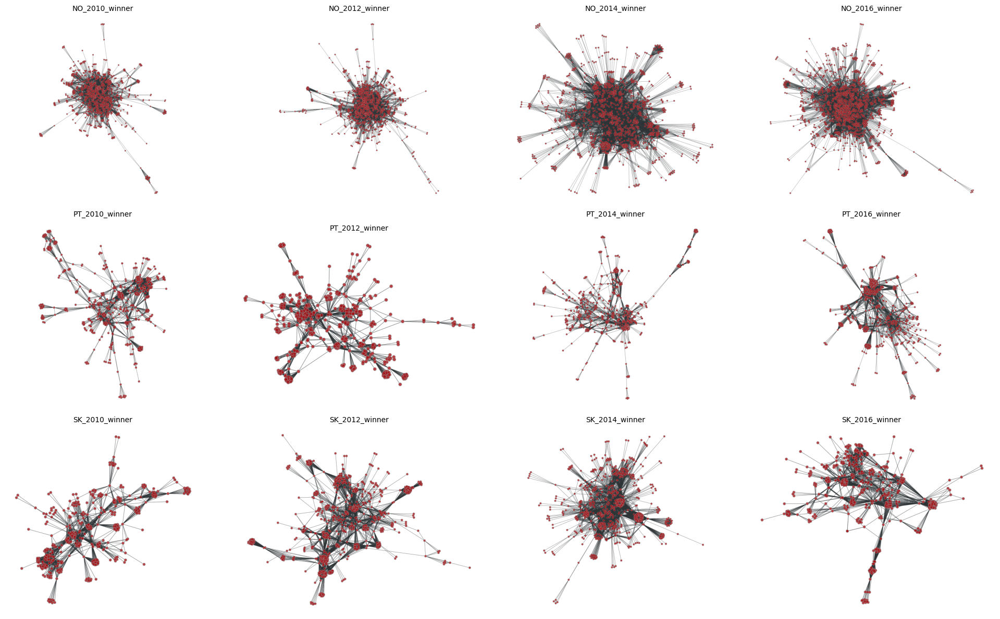

In [25]:
# Ensure the output directory exists
output_dir = "fr_layout_w"
os.makedirs(output_dir, exist_ok=True)

# Loop through each dataset and save the graph as an image
for network_title, g in winners_proj.items():
    u = gt.extract_largest_component(g, prune=True)
    pos = gt.fruchterman_reingold_layout(u, n_iter=100)
    output_path = os.path.join(output_dir, f"{network_title}.png")
    gt.graph_draw(u, pos, output=output_path)

# Get the list of all saved images
image_files = sorted([os.path.join(output_dir, f) for f in os.listdir(output_dir) if f.endswith('.png')])

# Create the figure with subplots
fig, axes = plt.subplots(rows, cols, figsize=(cols * 5, rows * 4))

# Flatten the axes array for easy iteration, in case of a 2D axes array
axes = axes.flatten()

# Loop through each image file and add it to the subplot
for i, image_file in enumerate(image_files):
    img = mpimg.imread(image_file)
    axes[i].imshow(img)
    axes[i].axis('off')  # Turn off the axis
    # Set the title for the subplot using the filename
    axes[i].set_title(image_file.split('/')[-1].replace('.png', ''), fontsize=10)

# Adjust layout and display
plt.tight_layout()
plt.show()

## Percolation

The percolation plots illustrate the change in network connectivity as nodes are systematically removed, capturing the critical threshold and the transition from a connected to a fragmented state. At the beginning when few nodes have been removed, all of the plots show a large connected component, indicating relatively well-connected networks (this is because we explicitly extract the largest component of the networks). While the critical threshold where the networks transition from a connected to a fragmented state vary slightly by country and by year, most all align very closely with a randomly generated network, perhaps with the exception of issuers from **Norway** in **2010** where the curve is much more gradual than what would be expected had the links between nodes been randomly generated.

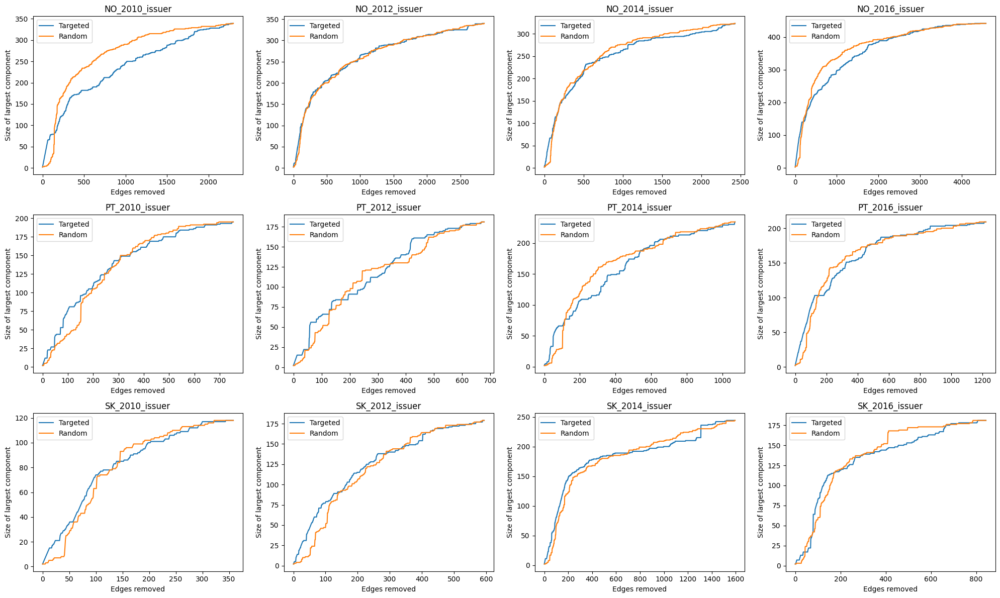

In [26]:
# Create the figure with subplots
fig, axes = plt.subplots(rows, cols, figsize=(cols * 5, rows * 4))

# Flatten the axes array for easy iteration
axes_flat = axes.flatten()

# Process each graph to calculate and plot the edge percolation
for i, (network_title, g) in enumerate(issuers_proj.items()):
    u = gt.extract_largest_component(g, prune=True)

    # Calculate edges sorted by the product of their vertex degrees for targeted percolation
    edges = sorted([(e.source(), e.target()) for e in u.edges()],
                   key=lambda e: e[0].in_degree() * e[1].in_degree(), reverse=True)

    # Perform targeted edge percolation
    sizes, comp = gt.edge_percolation(u, edges)

    # Shuffle edges for random percolation
    np.random.shuffle(edges)
    sizes2, comp2 = gt.edge_percolation(u, edges)

    # Plot the results on the subplot
    ax = axes_flat[i]
    ax.plot(sizes, label="Targeted")
    ax.plot(sizes2, label="Random")
    ax.set_title(network_title)
    ax.set_xlabel('Edges removed')
    ax.set_ylabel('Size of largest component')
    ax.legend()

# Adjust the layout and show the visualization
plt.tight_layout()
plt.show()

Compared with the percolation plots for issuers, those for winners deviate more from what would be expected of a network with randomly generated connections between nodes. In the case of **Norway**, the real values are consistently lower than those of the randomly generated values, while for **Portugal**, the real values are higher than those of the randomly generated values at different points in time. **Slovakia**'s percolation plots show observed values which are either above or below the randomly generated values depending on the given year. In several of the plots, large step-wise increases in the size of the largest component can also be observed, possibly representing clusters in the winners networks. This feature is more pronouned in the winners networks than in the issuers networks.

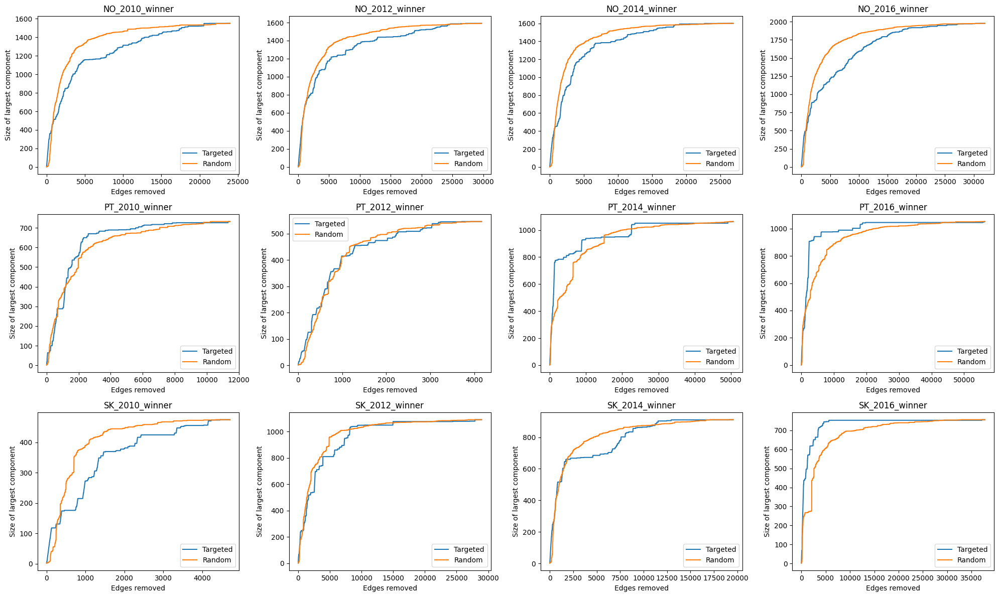

In [27]:
# Create the figure with subplots
fig, axes = plt.subplots(rows, cols, figsize=(cols * 5, rows * 4))

# Flatten the axes array for easy iteration
axes_flat = axes.flatten()

# Process each graph to calculate and plot the edge percolation
for i, (network_title, g) in enumerate(winners_proj.items()):
    u = gt.extract_largest_component(g, prune=True)

    # Calculate edges sorted by the product of their vertex degrees for targeted percolation
    edges = sorted([(e.source(), e.target()) for e in u.edges()],
                   key=lambda e: e[0].in_degree() * e[1].in_degree(), reverse=True)

    # Perform targeted edge percolation
    sizes, comp = gt.edge_percolation(u, edges)

    # Shuffle edges for random percolation
    np.random.shuffle(edges)
    sizes2, comp2 = gt.edge_percolation(u, edges)

    # Plot the results on the subplot
    ax = axes_flat[i]
    ax.plot(sizes, label="Targeted")
    ax.plot(sizes2, label="Random")
    ax.set_title(network_title)
    ax.set_xlabel('Edges removed')
    ax.set_ylabel('Size of largest component')
    ax.legend()

# Adjust the layout and show the visualization
plt.tight_layout()
plt.show()

## Centrality measures

A key step towards better understanding our network involves evaluating the relative importance of our nodes. Different centrality measures provide different perspectives on what it means to be "central" in a network, and can each help us to uncover patterns in the data.

### K-core decomposition

K-core decomposition allows us to gradually reduce the network to its most well-connected components. Consistent with what we have seen in the previous plots, **Norway**'s issuer network is more dense and centralized than those of Portugal and Slovakia. Again, in the case of both **Portugal** and **Slovakia**, distinct clusters appear to emerge in different segments of the issuers networks, while this does not appear to be the case for Norway.

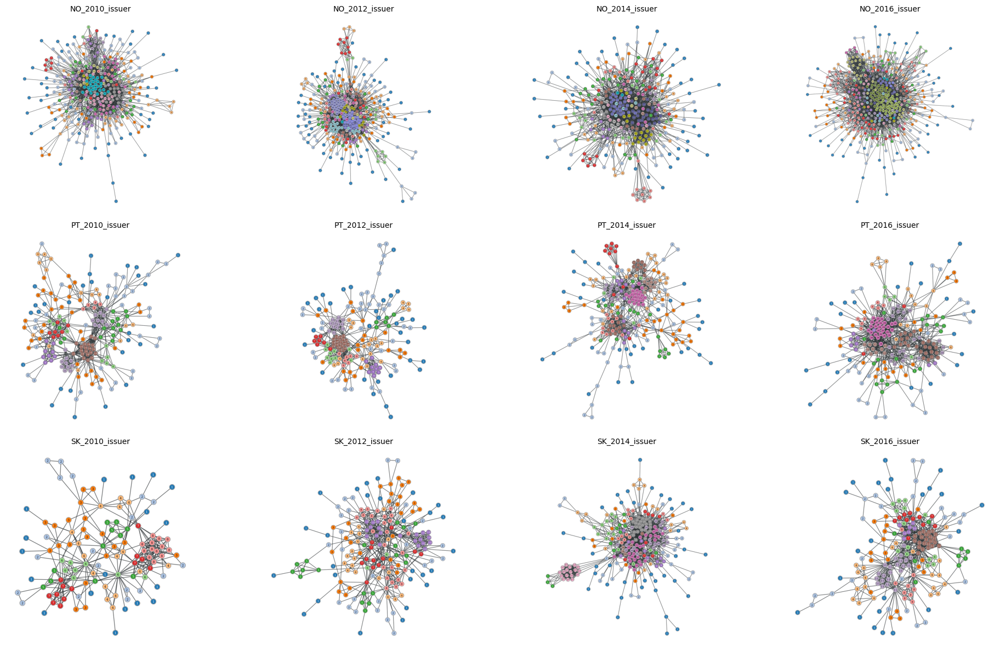

In [28]:
# Ensure the output directory exists for the stored images
output_dir_kcore = "kcore_i"
os.makedirs(output_dir_kcore, exist_ok=True)

# Generate k-core decomposition images for each graph
for network_title, g in issuers_proj.items():
    u = gt.extract_largest_component(g, prune=True)
    kcore = gt.kcore_decomposition(u)
    output_path = os.path.join(output_dir_kcore, f"{network_title}.png")
    gt.graph_draw(u, vertex_fill_color=kcore, vertex_text=kcore, output=output_path)

# Get the list of all saved images for the k-core decompositions
image_files_kcore = sorted([os.path.join(output_dir_kcore, f) for f in os.listdir(output_dir_kcore) if f.endswith('.png')])

# Create the figure with subplots for the k-core decompositions
fig, axes = plt.subplots(rows, cols, figsize=(cols * 5, rows * 4))

# Flatten the axes array for easy iteration
axes_flat = axes.flatten()

# Loop through each image file for the k-core decompositions and add it to the subplot
for i, image_file in enumerate(image_files_kcore):
    img = mpimg.imread(image_file)
    axes_flat[i].imshow(img)
    axes_flat[i].axis('off')  # Hide the axes
    # Set the title for the subplot
    axes_flat[i].set_title(image_file.split('/')[-1].replace('.png', ''), fontsize=10)

# Adjust the layout and show the visualization
plt.tight_layout()
plt.show()

Similar to what we have seen in other plots, the k-core decomposition reveals that there appear to be more clusters and more distinctly delineated communities in the winners' networks than the issuers' networks. Additionally, **Norway**'s network of winners appears more centralized than those of **Portugal** and **Slovakia**.

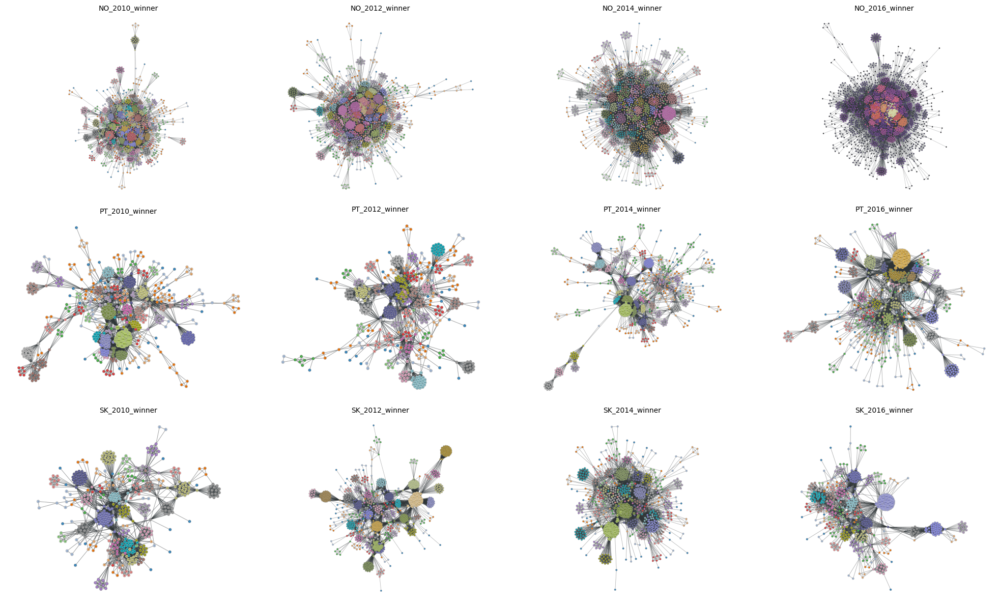

In [29]:
# Ensure the output directory exists for the stored images
output_dir_kcore = "kcore_w"
os.makedirs(output_dir_kcore, exist_ok=True)

# Generate k-core decomposition images for each graph
for network_title, g in winners_proj.items():
    u = gt.extract_largest_component(g, prune=True)
    kcore = gt.kcore_decomposition(u)
    output_path = os.path.join(output_dir_kcore, f"{network_title}.png")
    gt.graph_draw(u, vertex_fill_color=kcore, vertex_text=kcore, output=output_path)

# Get the list of all saved images for the k-core decompositions
image_files_kcore = sorted([os.path.join(output_dir_kcore, f) for f in os.listdir(output_dir_kcore) if f.endswith('.png')])

# Create the figure with subplots for the k-core decompositions
fig, axes = plt.subplots(rows, cols, figsize=(cols * 5, rows * 4))

# Flatten the axes array for easy iteration
axes_flat = axes.flatten()

# Loop through each image file for the k-core decompositions and add it to the subplot
for i, image_file in enumerate(image_files_kcore):
    img = mpimg.imread(image_file)
    axes_flat[i].imshow(img)
    axes_flat[i].axis('off')  # Hide the axes
    # Set the title for the subplot
    axes_flat[i].set_title(image_file.split('/')[-1].replace('.png', ''), fontsize=10)

# Adjust the layout and show the visualization
plt.tight_layout()
plt.show()

### PageRank centrality

PageRank centrality offers us a method for evaluating the importance of a node based on the number and quality of links connecting to it. As such, a link from a highly connected node might carry more weight than multiple links from less influential nodes. Consistent with the k-core decomposition plots, **Norway**'s most central nodes according to the PageRank method are in the center of the issuer networks. By contrast, both **Portugal** and **Slovakia**'s issuer networks' most "central" nodes appear to be scattered across distinct clusters that may not always be well-connected to one another, although the pattern is not stable across years.

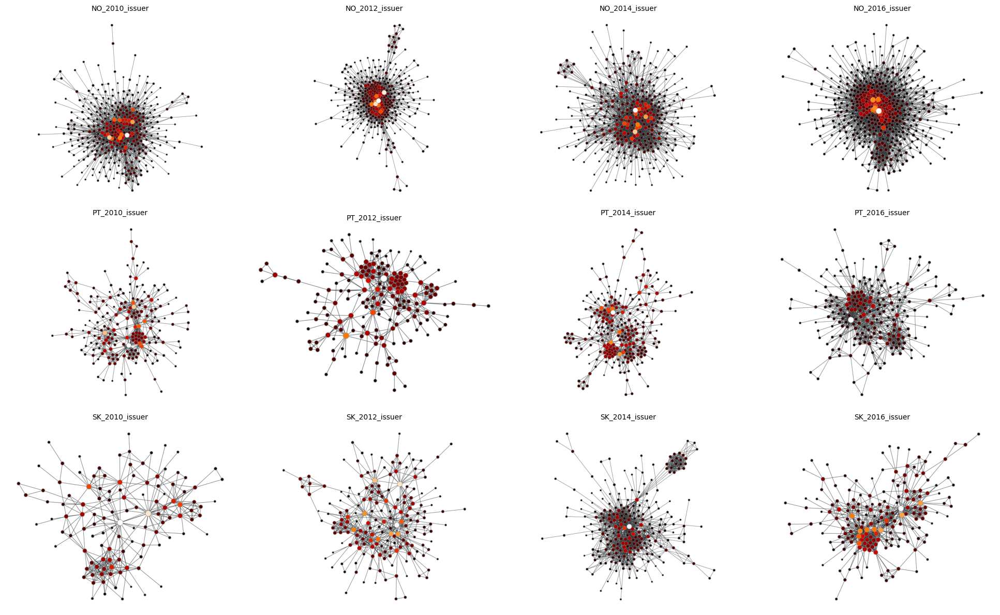

In [30]:
# Ensure the output directory exists for the PageRank images
output_dir_pr = "pagerank_i"
os.makedirs(output_dir_pr, exist_ok=True)

# Compute and visualize PageRank for each graph, and save as images
for network_title, g in issuers_proj.items():
    u = gt.extract_largest_component(g, prune=True)
    pos = gt.sfdp_layout(u) # SFDP layout

    # Calculate PageRank
    pr = gt.pagerank(u)

    # Save the visualization as an image
    output_path = os.path.join(output_dir_pr, f"{network_title}.png")
    gt.graph_draw(u, pos=pos, vertex_fill_color=pr,
                  vertex_size=gt.prop_to_size(pr, mi=5, ma=15),
                  vorder=pr, vcmap=matplotlib.cm.gist_heat,
                  output=output_path)

# Get the list of all saved images for PageRank visualizations
image_files_pr = sorted([os.path.join(output_dir_pr, f) for f in os.listdir(output_dir_pr) if f.endswith('.png')])

# Create the figure with subplots for the PageRank visualizations
fig, axes = plt.subplots(rows, cols, figsize=(cols * 5, rows * 4))

# Flatten the axes array for easy iteration
axes = axes.flatten()

# Loop through each image file for PageRank visualizations and add it to the subplot
for i, image_file in enumerate(image_files_pr):
    img = mpimg.imread(image_file)
    axes[i].imshow(img)
    axes[i].axis('off')  # Hide the axes
    # Set the title for the subplot
    axes[i].set_title(image_file.split('/')[-1].replace('.png', ''), fontsize=10)

# Adjust the layout and show the visualization
plt.tight_layout()
plt.show()

By comparison to the issuers networks, the "central" nodes in **Norway**'s winners networks are a bit more scattered and slightly less centralized. The winners networks for **Portugal** and **Slovakia** feature highgly "central" nodes that appear to be scattered across distinct clusters which may not always be well-connected to one another.

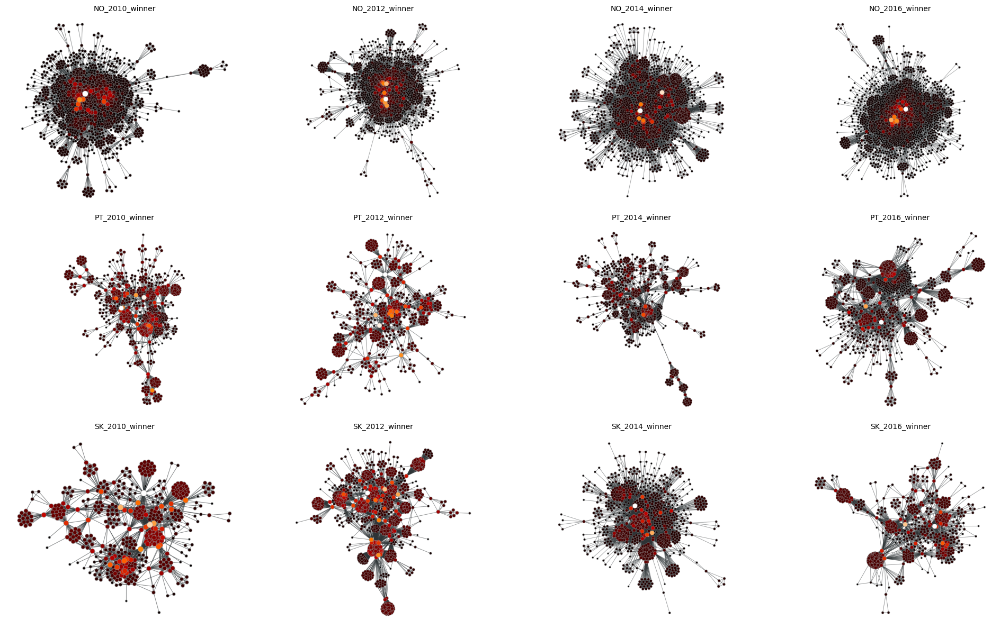

In [31]:
# Ensure the output directory exists for the PageRank images
output_dir_pr = "pagerank_w"
os.makedirs(output_dir_pr, exist_ok=True)

# Compute and visualize PageRank for each graph, and save as images
for network_title, g in winners_proj.items():
    u = gt.extract_largest_component(g, prune=True)
    pos = gt.sfdp_layout(u) # SFDP layout

    # Calculate PageRank
    pr = gt.pagerank(u)

    # Save the visualization as an image
    output_path = os.path.join(output_dir_pr, f"{network_title}.png")
    gt.graph_draw(u, pos=pos, vertex_fill_color=pr,
                  vertex_size=gt.prop_to_size(pr, mi=5, ma=15),
                  vorder=pr, vcmap=matplotlib.cm.gist_heat,
                  output=output_path)

# Get the list of all saved images for PageRank visualizations
image_files_pr = sorted([os.path.join(output_dir_pr, f) for f in os.listdir(output_dir_pr) if f.endswith('.png')])

# Create the figure with subplots for the PageRank visualizations
fig, axes = plt.subplots(rows, cols, figsize=(cols * 5, rows * 4))

# Flatten the axes array for easy iteration
axes = axes.flatten()

# Loop through each image file for PageRank visualizations and add it to the subplot
for i, image_file in enumerate(image_files_pr):
    img = mpimg.imread(image_file)
    axes[i].imshow(img)
    axes[i].axis('off')  # Hide the axes
    # Set the title for the subplot
    axes[i].set_title(image_file.split('/')[-1].replace('.png', ''), fontsize=10)

# Adjust the layout and show the visualization
plt.tight_layout()
plt.show()

### Betweenness centrality

Betweenness centrality allows us to quantify the role of a node in connecting other nodes within a network and to determien which nodes might play a large role in the network dynamics. Once again, a similar pattern emerges where **Norway**'s issuer networks feature nodes with high levels of betweenness near the center of the network. These nodes are very often very near each other in the plots. By contrast, both **Portugal** and **Slovakia**'s issuer networks feature many nodes with high betweenness that exist outside of the center of the network and may even be considered as part of different communities.

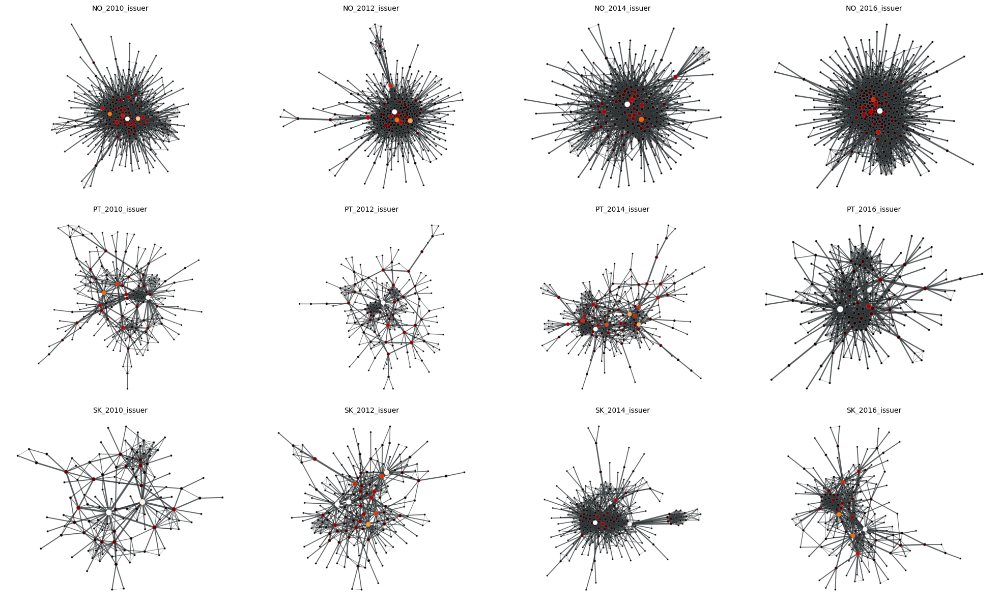

In [32]:
# Ensure the output directory exists for the betweenness images
output_dir_bt = "betweenness_i"
os.makedirs(output_dir_bt, exist_ok=True)

# Compute and visualize betweenness for each graph, and save as images
for network_title, g in issuers_proj.items():
    u = gt.extract_largest_component(g, prune=True)
    pos = gt.sfdp_layout(u) # SFDP layout

    # Calculate betweenness
    vp, ep = gt.betweenness(u)

    # Save the visualization as an image
    output_path = os.path.join(output_dir_bt, f"{network_title}.png")
    gt.graph_draw(u, pos=pos, vertex_fill_color=vp,
                  vertex_size=gt.prop_to_size(vp, mi=5, ma=15),
                  edge_pen_width=gt.prop_to_size(ep, mi=0.5, ma=5),
                  vcmap=matplotlib.cm.gist_heat, vorder=vp,
                  output=output_path)

# Get the list of all saved images for betweenness visualizations
image_files_bt = sorted([os.path.join(output_dir_bt, f) for f in os.listdir(output_dir_bt) if f.endswith('.png')])

# Create the figure with subplots for the betweenness visualizations
fig, axes = plt.subplots(rows, cols, figsize=(cols * 5, rows * 4))

# Flatten the axes array for easy iteration
axes = axes.flatten()

# Loop through each image file for betweenness visualizations and add it to the subplot
for i, image_file in enumerate(image_files_bt):
    img = mpimg.imread(image_file)
    axes[i].imshow(img)
    axes[i].axis('off')  # Hide the axes
    # Set the title for the subplot
    axes[i].set_title(image_file.split('/')[-1].replace('.png', ''), fontsize=10)

# Adjust the layout and show the visualization
plt.tight_layout()
plt.show()


**Norway**'s winner networks feature nodes with high levels of betweenness near the center of the network, though farther from the center than is the case in its issuer networks. Consistent with what was observed in their respective issuer networks, the winner networks of both **Portugal** and **Slovakia** feature many nodes with high betweenness that exist outside of the center of the network and may even be considered to belong to different communities.

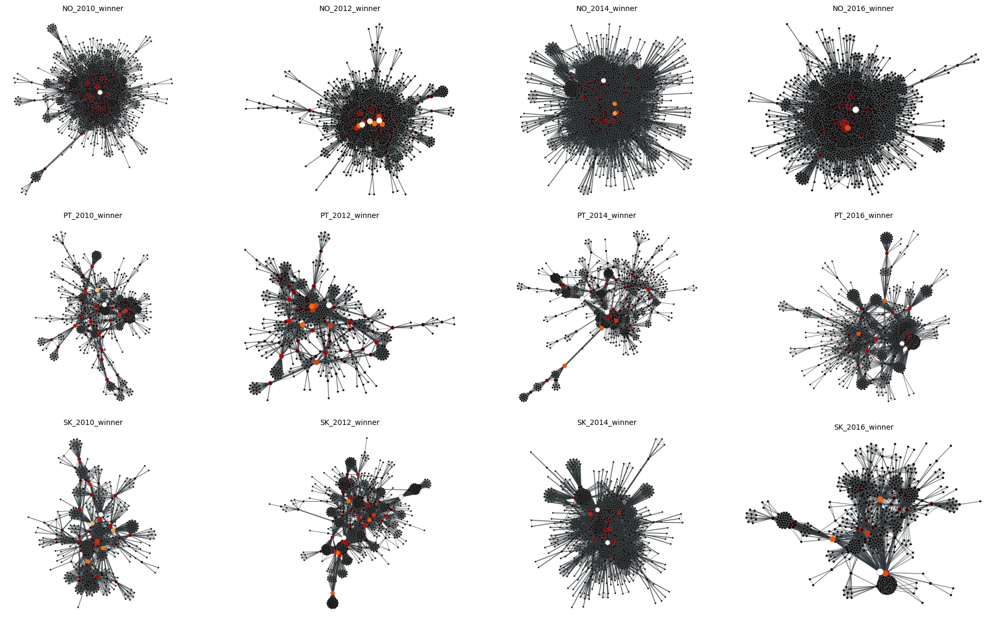

In [33]:
# Ensure the output directory exists for the betweenness images
output_dir_bt = "betweenness_w"
os.makedirs(output_dir_bt, exist_ok=True)

# Compute and visualize betweenness for each graph, and save as images
for network_title, g in winners_proj.items():
    u = gt.extract_largest_component(g, prune=True)
    pos = gt.sfdp_layout(u) # SFDP layout

    # Calculate betweenness
    vp, ep = gt.betweenness(u)

    # Save the visualization as an image
    output_path = os.path.join(output_dir_bt, f"{network_title}.png")
    gt.graph_draw(u, pos=pos, vertex_fill_color=vp,
                  vertex_size=gt.prop_to_size(vp, mi=5, ma=15),
                  edge_pen_width=gt.prop_to_size(ep, mi=0.5, ma=5),
                  vcmap=matplotlib.cm.gist_heat, vorder=vp,
                  output=output_path)

# Get the list of all saved images for betweenness visualizations
image_files_bt = sorted([os.path.join(output_dir_bt, f) for f in os.listdir(output_dir_bt) if f.endswith('.png')])

# Create the figure with subplots for the betweenness visualizations
fig, axes = plt.subplots(rows, cols, figsize=(cols * 5, rows * 4))

# Flatten the axes array for easy iteration
axes = axes.flatten()

# Loop through each image file for betweenness visualizations and add it to the subplot
for i, image_file in enumerate(image_files_bt):
    img = mpimg.imread(image_file)
    axes[i].imshow(img)
    axes[i].axis('off')  # Hide the axes
    # Set the title for the subplot
    axes[i].set_title(image_file.split('/')[-1].replace('.png', ''), fontsize=10)

# Adjust the layout and show the visualization
plt.tight_layout()
plt.show()

### Closeness centrality

Closeness centrality is another useful centrality measure. It quantifies how quickly a node can reach all other nodes in the network. Once again, the plots for show that **Norway**'s issuer network is highly centralized with the nodes with the highest levels of closeness centrality being located at the center of the issuer network and the level of closeness centrality gradually decreasing the farther nodes appear from the center. A more complicated picture emerges for both **Portugal** and **Slovakia** where the nodes with high levels of closeness centrality are not so concentrated in the center of the issuer networks. Notably, the plot for Slovakia's issuer network in 2014 makes the existence of a relatively large cluster distant from the center of the network at the top of the plot easily visible.

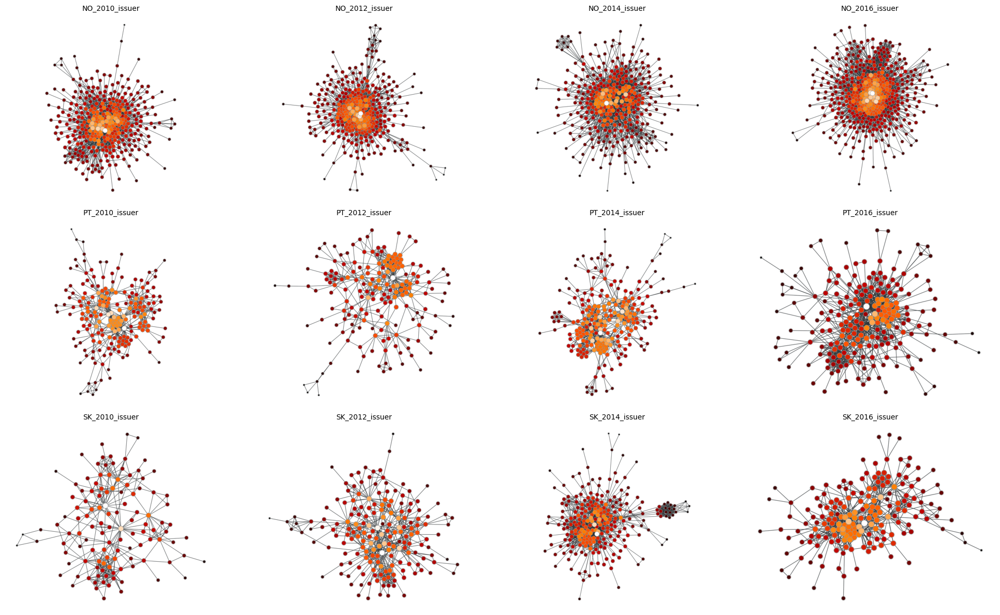

In [34]:
# Ensure the output directory exists for the closeness images
output_dir_cl = "closeness_i"
os.makedirs(output_dir_cl, exist_ok=True)

# Compute and visualize closeness for each graph, and save as images
for netowrk_title, g in issuers_proj.items():
    u = gt.extract_largest_component(g, prune=True)
    pos = gt.sfdp_layout(u) # SFDP layout

    # Calculate closeness centrality
    c = gt.closeness(u)

    # Save the visualization as an image
    output_path = os.path.join(output_dir_cl, f"{netowrk_title}.png")
    gt.graph_draw(u, pos=pos, vertex_fill_color=c,
                  vertex_size=gt.prop_to_size(c, mi=5, ma=15),
                  vcmap=matplotlib.cm.gist_heat, vorder=c,
                  output=output_path)

# Get the list of all saved images for closeness visualizations
image_files_cl = sorted([os.path.join(output_dir_cl, f) for f in os.listdir(output_dir_cl) if f.endswith('.png')])

# Create the figure with subplots for the closeness visualizations
fig, axes = plt.subplots(rows, cols, figsize=(cols * 5, rows * 4))

# Flatten the axes array for easy iteration
axes = axes.flatten()

# Loop through each image file for closeness visualizations and add it to the subplot
for i, image_file in enumerate(image_files_cl):
    img = mpimg.imread(image_file)
    axes[i].imshow(img)
    axes[i].axis('off')  # Hide the axes
    # Set the title for the subplot
    axes[i].set_title(image_file.split('/')[-1].replace('.png', ''), fontsize=10)

# Adjust the layout and show the visualization
plt.tight_layout()
plt.show()

When it comes to the winner networks, a similar pattern emerges. The interpretation of **Norway**'s plots does not differ much between its issuer networks and winner networks. The plots for both **Portugal** and **Slovakia** appear to be slightly more centralized as compared to their issuer networks, however, winner networks for both appear less dense than Norways' winners networks.

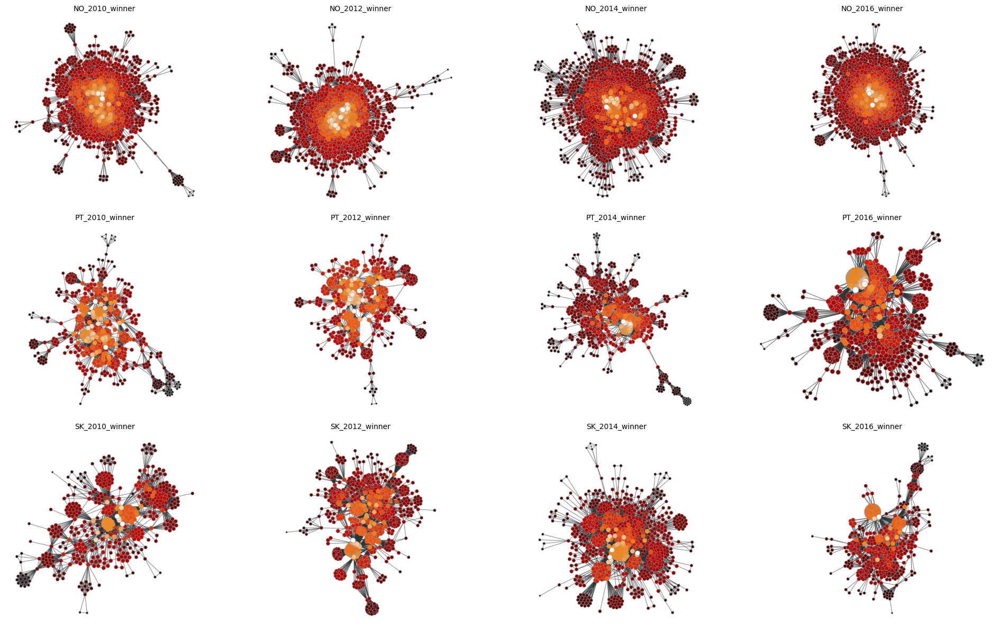

In [35]:
# Ensure the output directory exists for the closeness images
output_dir_cl = "closeness_w"
os.makedirs(output_dir_cl, exist_ok=True)

# Compute and visualize closeness for each graph, and save as images
for netowrk_title, g in winners_proj.items():
    u = gt.extract_largest_component(g, prune=True)
    pos = gt.sfdp_layout(u) # SFDP layout

    # Calculate closeness centrality
    c = gt.closeness(u)

    # Save the visualization as an image
    output_path = os.path.join(output_dir_cl, f"{netowrk_title}.png")
    gt.graph_draw(u, pos=pos, vertex_fill_color=c,
                  vertex_size=gt.prop_to_size(c, mi=5, ma=15),
                  vcmap=matplotlib.cm.gist_heat, vorder=c,
                  output=output_path)

# Get the list of all saved images for closeness visualizations
image_files_cl = sorted([os.path.join(output_dir_cl, f) for f in os.listdir(output_dir_cl) if f.endswith('.png')])

# Create the figure with subplots for the closeness visualizations
fig, axes = plt.subplots(rows, cols, figsize=(cols * 5, rows * 4))

# Flatten the axes array for easy iteration
axes = axes.flatten()

# Loop through each image file for closeness visualizations and add it to the subplot
for i, image_file in enumerate(image_files_cl):
    img = mpimg.imread(image_file)
    axes[i].imshow(img)
    axes[i].axis('off')  # Hide the axes
    # Set the title for the subplot
    axes[i].set_title(image_file.split('/')[-1].replace('.png', ''), fontsize=10)

# Adjust the layout and show the visualization
plt.tight_layout()
plt.show()

## Radial tree

Another aspect of networks that is closely connected to centrality and can aid our understanding of the underlying network structure is hierarchy. By computing a radial tree layout of the graph and placing the node with the maximum number of degrees at the center, we can learn something of the hierarchical structure of the network. For the issuers networks, we see that for **Norway** most nodes are only separate by 2-3 degrees from the highest degree node. The number of links present near the core of the issuer network is a further indication of the highly centralized nature of Norway's issuer network. For the issuer networks of both **Portugal** and **Slovakia**, most nodes are 3-4 degrees from the highest degree node, which appears to be more degrees than is the case for Norway while also containing less nodes. Furthermore, clusters of links can be found in corners of the radial trees for both countries, further indicating that clusters exist apart from the core of the network.

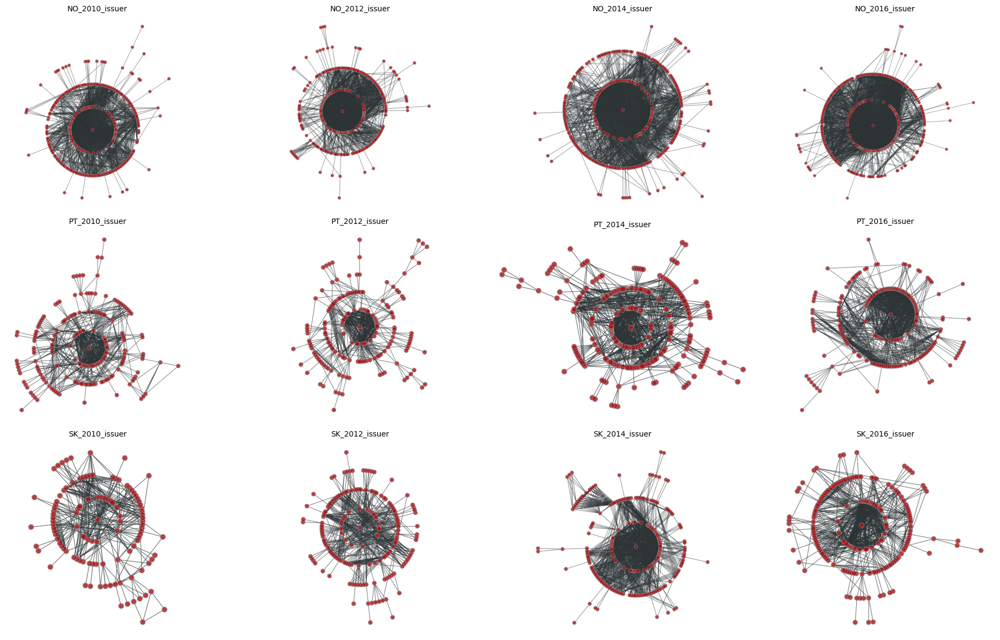

In [36]:
# Ensure the output directory exists for the stored positions
output_dir_vp = "tree_layout_i"
os.makedirs(output_dir_vp, exist_ok=True)

# Assume datasets is a dict with Graph-tool graphs
for network_title, g in issuers_proj.items():
    u = gt.extract_largest_component(g, prune=True)

    # Find the vertex with the maximum degrees
    degrees = u.get_total_degrees(u.get_vertices())
    maximum = max(degrees)
    max_degree_vertices = np.where(degrees == maximum)[0]

    # If there are multiple vertices with the maximum in-degree, choose one
    central_vertex = u.vertex(max_degree_vertices[0])

    # Compute the radial tree layout from the central vertex
    pos_tree = gt.radial_tree_layout(u, central_vertex)

    # Save the graph drawing with radial tree layout
    output_path = os.path.join(output_dir_vp, f"{network_title}.png")
    gt.graph_draw(u, pos=pos_tree, output=output_path)


# Get the list of all saved images for the stored positions
image_files_vp = sorted([os.path.join(output_dir_vp, f) for f in os.listdir(output_dir_vp) if f.endswith('.png')])

# Create the figure with subplots for the stored positions
fig, axes = plt.subplots(rows, cols, figsize=(cols * 5, rows * 4))

# Flatten the axes array for easy iteration
axes = axes.flatten()

# Loop through each image file for the stored positions and add it to the subplot
for i, image_file in enumerate(image_files_vp):
    # Read each graph from its saved file
    img = mpimg.imread(image_file)
    axes[i].imshow(img)
    axes[i].axis('off')  # Hide the axes
    # Set the title for the subplot
    axes[i].set_title(image_file.split('/')[-1].replace('.png', ''), fontsize=10)

# Adjust the layout and show the visualization
plt.tight_layout()
plt.show()

Glancing at the winner networks, it becomes immediately evident that there are more links in these networks. Once again, **Norway**'s winner networks are highly connected and highly centralized. This is evidenced by the high level of connectivity in and around the core of the radial tree diagram as well as the fact that few nodes exist more than 3-4 degrees away from the core node. As mentioned before, the winner networks for both **Portugal** and **Slovakia** are vary substantially from year to year. However, in all cases, the centers of their respective radial trees are not nearly as full of connections. Additionally, it appears that a greater proportion of nodes exist more than 3-4 degrees from the central node, although this varies quite a bit from year to year.

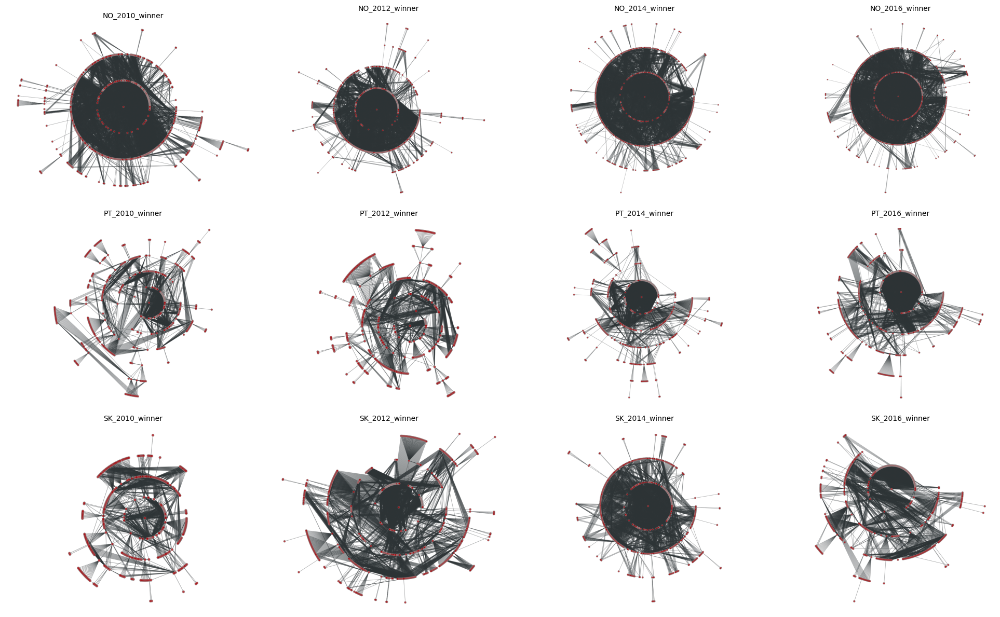

In [37]:
# Ensure the output directory exists for the stored positions
output_dir_vp = "tree_layout_w"
os.makedirs(output_dir_vp, exist_ok=True)

# Assume datasets is a dict with Graph-tool graphs
for network_title, g in winners_proj.items():
    u = gt.extract_largest_component(g, prune=True)

    # Find the vertex with the maximum degrees
    degrees = u.get_total_degrees(u.get_vertices())
    maximum = max(degrees)
    max_degree_vertices = np.where(degrees == maximum)[0]

    # If there are multiple vertices with the maximum in-degree, choose one
    central_vertex = u.vertex(max_degree_vertices[0])

    # Compute the radial tree layout from the central vertex
    pos_tree = gt.radial_tree_layout(u, central_vertex)

    # Save the graph drawing with radial tree layout
    output_path = os.path.join(output_dir_vp, f"{network_title}.png")
    gt.graph_draw(u, pos=pos_tree, output=output_path)


# Get the list of all saved images for the stored positions
image_files_vp = sorted([os.path.join(output_dir_vp, f) for f in os.listdir(output_dir_vp) if f.endswith('.png')])

# Create the figure with subplots for the stored positions
fig, axes = plt.subplots(rows, cols, figsize=(cols * 5, rows * 4))

# Flatten the axes array for easy iteration
axes = axes.flatten()

# Loop through each image file for the stored positions and add it to the subplot
for i, image_file in enumerate(image_files_vp):
    # Read each graph from its saved file
    img = mpimg.imread(image_file)
    axes[i].imshow(img)
    axes[i].axis('off')  # Hide the axes
    # Set the title for the subplot
    axes[i].set_title(image_file.split('/')[-1].replace('.png', ''), fontsize=10)

# Adjust the layout and show the visualization
plt.tight_layout()
plt.show()

## Community detection

In addition to measures of centrality and hierarchy, community detectionis another useful tool for understand the underlying structure of our networks and to group together functional units.

### Local clustering coefficients

The local clustering coefficient of a node measures the fraction of its neighbors that are also neighbors of each other. It reflects the degree to which a node's neighbors are interconnected. Ranging from 0 to 1, a value of 0 indicates that none of the node's neighbors are connected, while a value of 1 indicates that all of the node's neighbors are connected to each other. The average local clustering coefficients for the issuer networks are all above 0.5, meaning that these nodes, on average, are connected with over half of their neighbors within their clusters. These rates are relatively similar across all countries and years examined, ranging from 0.56-0.69.

In [38]:
# Loop through each graph and calculate the local clustering coefficient
for network_title, g in issuers_proj.items():
    u = gt.extract_largest_component(g, prune=True)  # Extract the largest component

    # Calculate local clustering for each vertex in the graph
    clust = gt.local_clustering(u)

    # Calculate and print the average local clustering coefficient
    average_clust = gt.vertex_average(u, clust)
    print(network_title, round(average_clust[0], 2))


NO_2010_issuer 0.59
NO_2012_issuer 0.59
NO_2014_issuer 0.6
NO_2016_issuer 0.64
PT_2010_issuer 0.65
PT_2012_issuer 0.61
PT_2014_issuer 0.63
PT_2016_issuer 0.69
SK_2010_issuer 0.56
SK_2012_issuer 0.6
SK_2014_issuer 0.65
SK_2016_issuer 0.65


The average local clustering coefficients for the winner networks are all above 0.85, meaning that these nodes, on average, are connected with nearly all of their neighbors within their clusters. These rates are relatively similar across all countries and years examined, ranging from 0.86-0.92.

In [39]:
# Loop through each graph and calculate the local clustering coefficient
for network_title, g in winners_proj.items():
    u = gt.extract_largest_component(g, prune=True)  # Extract the largest component

    # Calculate local clustering for each vertex in the graph
    clust = gt.local_clustering(u)

    # Calculate and print the average local clustering coefficient
    average_clust = gt.vertex_average(u, clust)
    print(network_title, round(average_clust[0], 2))

NO_2010_winner 0.89
NO_2012_winner 0.89
NO_2014_winner 0.89
NO_2016_winner 0.87
PT_2010_winner 0.89
PT_2012_winner 0.86
PT_2014_winner 0.91
PT_2016_winner 0.92
SK_2010_winner 0.88
SK_2012_winner 0.92
SK_2014_winner 0.9
SK_2016_winner 0.92


### Stochastic block model (SBM)



SBM represents a probabilistic approach towards identifying communities within networks. When it comes to **Norway**'s issuer networks, numerous communities have been identified, many of which are concentrated in the center of the network, making it difficult to draw sweeping conclusions about the structure. With respect to **Portugal**'s issuer network, the communities are more distinct from one another, although there tends to be more overlap near the center of the network which is to be expected. Lastly, **Slovakia**'s issuer networks are perhaps easiest to interpret since there are relatively few communities with relatively little overlap. Once again, there is a higher concentration of communities towards the center of the network, conrresponding with the higher concentration of nodes.

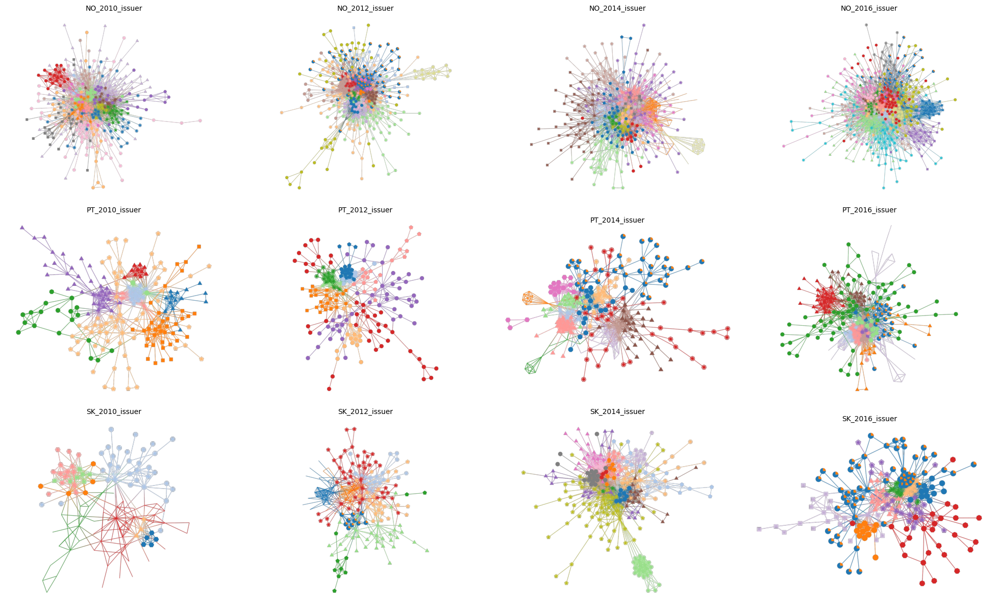

In [40]:
# Ensure the output directory exists for the blockmodel images
output_dir_bm = "blockmodel_i"
os.makedirs(output_dir_bm, exist_ok=True)

# Compute and visualize the blockmodel for each graph, and save as images
for network_title, g in issuers_proj.items():
    # Extract the largest component
    u = gt.extract_largest_component(g, prune=True)
    pos = gt.sfdp_layout(u) # SFDP layout

    # Minimize the blockmodel description length
    state = gt.minimize_blockmodel_dl(u)

    # Save the visualization as an image
    output_path = os.path.join(output_dir_bm, f"{network_title}.png")
    state.draw(pos=pos, vertex_shape=state.get_blocks(), output=output_path)

# Get the list of all saved images for blockmodel visualizations
image_files_bm = sorted([os.path.join(output_dir_bm, f) for f in os.listdir(output_dir_bm) if f.endswith('.png')])

# Create the figure with subplots for the blockmodel visualizations
fig, axes = plt.subplots(rows, cols, figsize=(cols * 5, rows * 4))

# Flatten the axes array for easy iteration
axes = axes.flatten()

# Loop through each image file for blockmodel visualizations and add it to the subplot
for i, image_file in enumerate(image_files_bm):
    img = mpimg.imread(image_file)
    axes[i].imshow(img)
    axes[i].axis('off')  # Hide the axes
    # Set the title for the subplot
    axes[i].set_title(image_file.split('/')[-1].replace('.png', ''), fontsize=10)

# Adjust the layout and show the visualization
plt.tight_layout()
plt.show()

With respect to the winner networks, there appear to be a greater number of distinct communities across the board when compared to the issuer networks above. Additionally, the delineations appear to be more distinct between groups, that is to say there appears to be a bit less overlap between the detected communities, perhaps indicating that we can be more certain about the results of the SBM decomposition. This structure may be indicative of the fact that many winners may only have contracts with one issuers, thus contributing to the clustering effect.

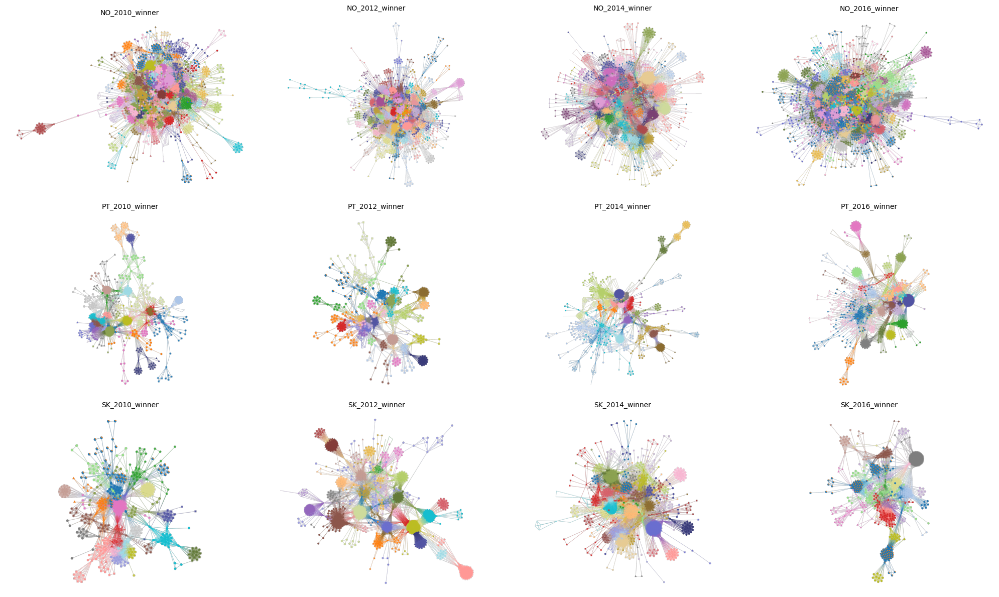

In [41]:
# Ensure the output directory exists for the blockmodel images
output_dir_bm = "blockmodel_w"
os.makedirs(output_dir_bm, exist_ok=True)

# Compute and visualize the blockmodel for each graph, and save as images
for network_title, g in winners_proj.items():
    # Extract the largest component
    u = gt.extract_largest_component(g, prune=True)
    pos = gt.sfdp_layout(u) # SFDP layout

    # Minimize the blockmodel description length
    state = gt.minimize_blockmodel_dl(u)

    # Save the visualization as an image
    output_path = os.path.join(output_dir_bm, f"{network_title}.png")
    state.draw(pos=pos, vertex_shape=state.get_blocks(), output=output_path)

# Get the list of all saved images for blockmodel visualizations
image_files_bm = sorted([os.path.join(output_dir_bm, f) for f in os.listdir(output_dir_bm) if f.endswith('.png')])

# Create the figure with subplots for the blockmodel visualizations
fig, axes = plt.subplots(rows, cols, figsize=(cols * 5, rows * 4))

# Flatten the axes array for easy iteration
axes = axes.flatten()

# Loop through each image file for blockmodel visualizations and add it to the subplot
for i, image_file in enumerate(image_files_bm):
    img = mpimg.imread(image_file)
    axes[i].imshow(img)
    axes[i].axis('off')  # Hide the axes
    # Set the title for the subplot
    axes[i].set_title(image_file.split('/')[-1].replace('.png', ''), fontsize=10)

# Adjust the layout and show the visualization
plt.tight_layout()
plt.show()

### Nested stochastic block model (SBM)

Connected to the SBM decomposition plotted above is nested SBM which offers another way of visualizing the communities and the overlap between them that may be easier to intuitively grasp. The number of communities in **Norway**'s issuer network identifed by nested SBM increases with the years. It is difficult to interpret this finding without taking a closer look at the nodes in each community to assess whether the community detection is successful. In principle, public institutions tend to remain stable over time with some occassional minor bureaucratic reshuffling, so it would be surprising in the number of public institutions responsible for issuing public contracts did in fact change significantly over the six year time period. Beyond this, we can see that there are many nodes connected to nodes of other communities, showing that the network is highly interconnected. With regard to **Portugal**, there is some slight fluctuation in the number of communities detected across years, but this figure remains more stable over time than Norway's. While there is a measure of connection between nodes of different communities, it is less than in Norway's case. The number of community partitions for **Slovakia**'s issuer network changes drastically depending on the year, which warrants further investigation. Overall, the amount of connections across nodes of different communities is similar to the level observed in Portugal's issuer network.

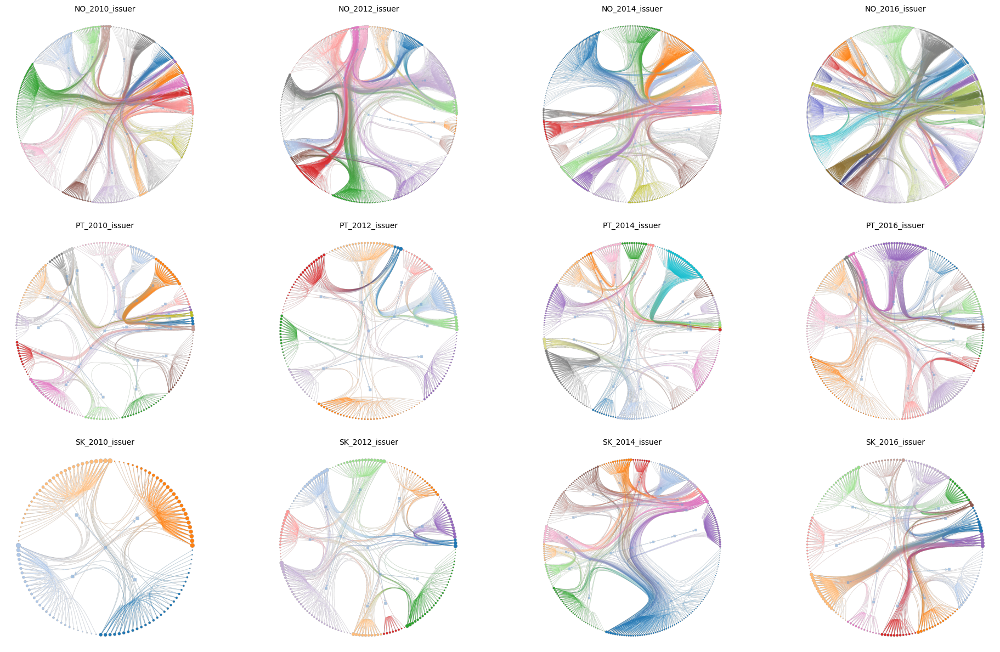

In [42]:
# Ensure the output directory exists for the nested blockmodel images
output_dir_nbm = "blockmodel_nested_i"
os.makedirs(output_dir_nbm, exist_ok=True)

# Compute and visualize the nested blockmodel for each graph, and save as images
for network_title, g in issuers_proj.items():
    # Extract the largest component
    u = gt.extract_largest_component(g, prune=True)

    # Compute the nested blockmodel
    state = gt.minimize_nested_blockmodel_dl(u)

    # Save the visualization as an image
    output_path = os.path.join(output_dir_nbm, f"{network_title}.png")
    state.draw(output=output_path)  # Draw and save the visualization

# Get the list of all saved images for nested blockmodel visualizations
image_files_nbm = sorted([os.path.join(output_dir_nbm, f) for f in os.listdir(output_dir_nbm) if f.endswith('.png')])

# Create the figure with subplots for the nested blockmodel visualizations
fig, axes = plt.subplots(rows, cols, figsize=(cols * 5, rows * 4))

# Flatten the axes array for easy iteration
axes = axes.flatten()

# Loop through each image file for nested blockmodel visualizations and add it to the subplot
for i, image_file in enumerate(image_files_nbm):
    img = mpimg.imread(image_file)
    axes[i].imshow(img)
    axes[i].axis('off')  # Hide the axes
    # Set the title for the subplot
    axes[i].set_title(image_file.split('/')[-1].replace('.png', ''), fontsize=10)

# Adjust the layout and show the visualization
plt.tight_layout()
plt.show()

What is striking about **Norway**'s winner networks is not only the sheer number of nodes and communities, but also the way in which no single node or community appears to dominate. This could be caused by bias introduced by the nested SBM methodology, but it does seem to suggest in comparison to the plots for **Portugal** and **Slovakia** that there is no dominant business, supporting previous research that suggests that Norway has a low level of corruption. Turning our attention to both Portugal and Slovakia, we see that for several of the years examined, the winner networks contain a dominant community (e.g., Portugal in 2010, 2014, and 2016, and Slovakia in all years, although this feature is most pronouned in 2016). This may be accounted for by the fact that both countries have one ministry that enters into an outsized number of contracts, though further investigation would be required to confirm these hunches.

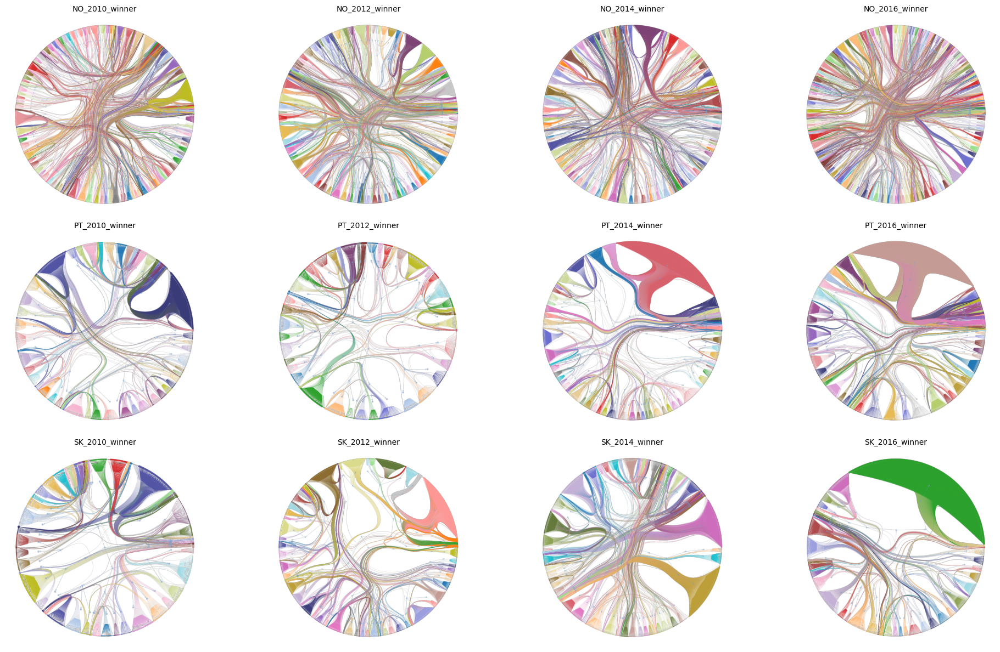

In [43]:
# Ensure the output directory exists for the nested blockmodel images
output_dir_nbm = "blockmodel_nested_w"
os.makedirs(output_dir_nbm, exist_ok=True)

# Compute and visualize the nested blockmodel for each graph, and save as images
for network_title, g in winners_proj.items():
    # Extract the largest component
    u = gt.extract_largest_component(g, prune=True)

    # Compute the nested blockmodel
    state = gt.minimize_nested_blockmodel_dl(u)

    # Save the visualization as an image
    output_path = os.path.join(output_dir_nbm, f"{network_title}.png")
    state.draw(output=output_path)  # Draw and save the visualization

# Get the list of all saved images for nested blockmodel visualizations
image_files_nbm = sorted([os.path.join(output_dir_nbm, f) for f in os.listdir(output_dir_nbm) if f.endswith('.png')])

# Create the figure with subplots for the nested blockmodel visualizations
fig, axes = plt.subplots(rows, cols, figsize=(cols * 5, rows * 4))

# Flatten the axes array for easy iteration
axes = axes.flatten()

# Loop through each image file for nested blockmodel visualizations and add it to the subplot
for i, image_file in enumerate(image_files_nbm):
    img = mpimg.imread(image_file)
    axes[i].imshow(img)
    axes[i].axis('off')  # Hide the axes
    # Set the title for the subplot
    axes[i].set_title(image_file.split('/')[-1].replace('.png', ''), fontsize=10)

# Adjust the layout and show the visualization
plt.tight_layout()
plt.show()

# Save subsets of networks

Lastly, let's save the version of the networks that we used for this analysis, so that we can easily reproduce our results, as needed.  

In [44]:
output_dir_u = "processed"
os.makedirs(output_dir_u, exist_ok=True)

for network_title, g in networks_proj.items():
  u = gt.extract_largest_component(u, prune=True)

  # Save the visualization as an image
  output_path = os.path.join(output_dir_u, f"{network_title}.gml")
  u.save(output_path, fmt="gml")

## Sources
* [`eu_procurements_alt`](https://networks.skewed.de/net/eu_procurements_alt) EU national procurement networks (2008-2016) dataset
* J. Wachs, M. Fazekas, and J. Kertész; "Corruption Risk in Contracting Markets: A Network Science Perspective." International Journal of Data Science and Analytics, pp 1–16 (2020), https://doi.org/10.1007/s41060-019-00204-1.
* A. Barabási; *Network Science*. Cambridge University Press (2015), http://www.networksciencebook.com/.
* T. Fruchterman and E. Reingold; "Graph drawing by force-directed placement." Journal of Software: Practice and Experience, pp 1129-1164 (1991), https://doi.org/10.1002/spe.4380211102.
* [`NetworkX` Documentation](https://networkx.org/documentation/stable/)
* [`graph-tool` Documentation](https://graph-tool.skewed.de/static/doc/index.html)
* [DataCamp | Python Tutorial: Bipartite graphs](https://www.youtube.com/watch?v=IjomzV8Crxg)
* Contracts data dictionary associated with the `eu_procurements` data set can be found [here](https://zenodo.org/records/3537986).
* Code provided by [Tiago P. Peixoto (@count0)](https://github.com/count0/colab-gt/blob/master/colab-gt.ipynb) enabled the use of the graph-tool package in the Colab environment.
* [How to Use Graph-Tool in Google Colab](https://colab.research.google.com/github/count0/colab-gt/blob/master/colab-gt.ipynb#scrollTo=GQ18Kd5F3uKe)